az raveshe genetic algorithm baraye halle masale estefade mikonim.

masale ra ingoone model mikonim ke har chromosome moteshakel az k rang ast ke k center e cluster hayeman ra moshakhas mikonad. va dar nahayat har pixel rangash be rangi taghir mikonad ke kamtarin fasele ra ba an darad (az beine k center).

baraye crossover as single crossover estefade mikonim be in goone ke yek adad beine 1 ta k-1 random entekhab mikonim be name i va bache haye c1 va c2 ra az rooye p1 va p2 ingoone misazim: c1 = p1[:i] + p2[i:] va x2 = p2[:i] + p1[i:].

baraye mutation: 2 ravesh darim:

raveshe avval ingoone ke yek chromosome ra entekhab mikonim va be soorate random har k center ra be rang haye random taghir midahim.

raveshe dovvom ingoone ast ke yeki az k markaz ra random dar chromose entekhab mikonim va be adadi random taghir midahim.

dar amal ravashe dovom behine tar bood pas az an estefade mikonim.
tabe e raveshe avval mutation1 ast. va az mutation estefade shode

va baraye inke dar nahayat jamiat sari tar converge konad fazaye jostejoo ra be ranghayee ke dar aks estefade shode kahesh midahim.

baraye har aks tamame rang haye unique i ke dar an amade ast ra avval peida mikonim va sepas har gah ke khastim range randomi entekhab konim az in rang ha entekhab mikonim.

tabe e init2 ingoone ast ke be jaye inke az arayeye rang ha estefade konad, avval baraye har rang yek adade random dar bazeye intensity aks entekhab mikonad va sepas yek rang ke intensity an barabare in adad ast ra be random entekhab mikonad. ide ye in kar be in dalil ast ke be rang hayee ke shabihe an ha rang kamtar ast shanse bishtari baraye entekhab shodan bedahad va algorithm rang haye shabihe ham kamtar entekhab konad vali dar amal in ravesh fitnesse behtari ijad nemikard pas az raveshe ghab estefade shode. mutation2 tabe e mutation e motenaseb ba in ravesh ast.

dar nahayat mibinim ke chon algorithm fitness barayash mohem ast va cytoplasm dar kheili aks ha meghdare kheili kami az tasvir ra tashkil midahad va hamchenin range kheili motefaveti nadarad. aksaran cytoplasm range motefaveti ba bakhs haye bi ahamiate digar nadarad ya hamrang nuclues rang amizi shode. vali dar aksare aks ha algorithm tavaneste nuclues ra az baghieye aks joda konad

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import random
import matplotlib.pyplot as plt
colors = []
BWI = []
Imin = 0
Imax = 0

tabe e init psize va k ra migirad va jamiati be size e psize va ba k markaz random az rang haye mojood dar aks generate mikonad va barmigardanad

In [ ]:
def init(psize, k):
  global colors
  index = np.random.randint(len(colors), size = (psize, k))
  population = np.zeros((psize, k, 3))
  for i in range(len(colors)):
    row, col = np.where(index == i)
    if(len(row) == 0):
      continue
    population[row, col] = colors[i]
  return population

In [ ]:
def init2(psize, k):
  global colors
  global BWI
  global Imin
  global Imax
  print(Imin, Imax)
  index = list(np.random.randint(int(Imin), int(Imax), size = (psize, k)))
  population = np.zeros((psize, k, 3))
  for i in range(len(population)):
    for j in range(k):
      l = np.searchsorted(BWI, index[i][j], side='left')
      r = np.searchsorted(BWI, index[i][j], side='right')
      #print(l, r, index[i][j])
      #print(BWI[l], BWI[r])
      col = np.random.randint(l, r + 1, size = 1)
      col = col[0]
      #print(l, r, col)
      population[i][j] = colors[col]
  return population

tabe e dist faseleye euclidean ra hesab mikonad vaghti ke voroodi 3 bodi ast va dist 2 vaghti voroodi 2 bodi ast

In [ ]:
def dist(a, b):
  return np.linalg.norm(a - b, axis = 2)

In [ ]:
def dist2(a, b):
  return np.linalg.norm(a - b, axis = 1)

tabe e getdist x va centers ra migirad va araye i barmigardanad ke faseleye har noghte az x va har noghte dar centers ( ke x akse ma va centers marakeze cluster hastand) ra barmigardanad

In [ ]:
def getdist(x, centers):
  ans = []
  for center in centers:
    ans.append(dist(x, center))
  return ans

tabe e paint akse img va marakeze clustere centers ra migirad va akse jadidi ke ba tavajoh be in cluster bandi ijad mishavad ra chap mikonad va barmigardanad

In [ ]:
def paint(img, centers):
  newpic = img.copy()
  k = len(centers)
  d = getdist(img, centers)
  choose = np.argmin(d, axis = 0)
  for i in range(k):
    row, col = np.where(choose == i)
    if(row.size == 0):
      continue
    newpic[row, col] = centers[i]
  cv2_imshow(newpic)
  return newpic

tabe e fitness img va centers ra migirad va fitness e in chromosome ra ( marakeze cluster ha) ra baraye in aks barmigardanad

In [ ]:
def fitness(img, gnome):
  d = getdist(img, gnome)
  return np.sum(np.amin(d, axis = 0))

tabe e getfit arayeye fitness e tamame azaye population ra barmigardanad

In [ ]:
def getfit(population, img):
  fit = []
  for gnome in population:
    fit.append(fitness(img, gnome))
  return fit

In [ ]:
def selection(population, size):
  return population[:size,:]

ravesh haye crossover va mutation dar avvale code tozih dade shod

In [ ]:
def crossover(population, rate, k):
  children = []
  n = len(population)
  for i in range(int(n * rate)):
    parents = random.sample(range(0, len(population)), 2)
    #print(parents)

    p1 = population[parents[0]]
    p2 = population[parents[1]]

    cpoint = np.random.choice(k - 1, 1)
    cpoint = cpoint[0]

    c1 = np.concatenate((p1[:cpoint + 1, :], p2[cpoint + 1:, :]), axis = 0)
    c2 = np.concatenate((p2[:cpoint + 1, :], p1[cpoint + 1:, :]), axis = 0)

    children.append(c1)
    children.append(c2)

  return children

In [ ]:
def mutation1(children, rate, k):
  global colors
  n = len(children)
  choose = random.sample(range(0,n), int(n * rate))
  for choice in choose:
    newpointindex = random.sample(range(0,len(colors)), k)
    newpoint = colors[newpointindex]
    children[choice] = newpoint
    #i = random.sample(range(0,k), 1)
    #i = i[0]
    #j = random.sample(range(0, len(colors)), 1)
    #j = j[0]
    #children[choice][i] = colors[j]
  return children

In [ ]:
def mutation(children, rate, k):
  global colors
  n = len(children)
  choose = random.sample(range(0,n), int(n * rate))
  for choice in choose:
    #newpointindex = random.sample(range(0,len(colors)), k)
    #newpoint = colors[newpointindex]
    #children[choice] = newpoint
    i = random.sample(range(0,k), 1)
    i = i[0]
    j = random.sample(range(0, len(colors)), 1)
    j = j[0]
    children[choice][i] = colors[j]
  return children

In [ ]:
def mutation2(children, rate, k):
  global colors
  global BWI
  global Imin
  global Imax
  n = len(children)
  choose = random.sample(range(0,n), int(n * rate))
  for choice in choose:
    #newpointindex = random.sample(range(0,len(colors)), k)
    #newpoint = colors[newpointindex]
    #children[choice] = newpoint
    i = random.sample(range(0,k), 1)
    i = i[0]
    j = random.sample(range(Imin, Imax), 1)
    j = j[0]
    l = np.searchsorted(BWI, j, side='left')
    r = np.searchsorted(BWI, j, side='right')

    col = np.random.randint(l, r + 1, size = 1)
    col = col[0]
    children[choice][i] = colors[col]
  return children

tabe e GA ke dar nahayat genetic algorithm ra baraye aks dade shode ejra mikonad. ba test haye motefavet dide shod ke mutation rate va crossover rate 0.5 natayeje matloobi be ma midahad alave bar inke sari ast. hamchenin population size e 20 ba 20 iteration be javab converge mikard. mitavanim moshakhasan size e population va tedad iteration hara ziad konim vali dar amali taghire ziadi dar fitness kol ijad nakard vali code ra be shedat kond tar kard. ba afzayeshe k bishtar az 5 fitness behbood yaft vali taghiri dar taskhise azaye aks ijad nashod.

In [ ]:
def GA(img, population_size, k, mutation_rate, crossover_rate, iterations):
  population = np.array(init(2 * population_size, k))
  answers = []
  for _ in range(iterations):
    pfit = np.array(getfit(population, img))
    index = np.argsort(pfit)
    population = population[index]
    pfit = pfit[index]
    #print(_, pfit[0] / (257 * 257))
    #paint(img, population[0])
    #print(_, pfit[-1])
    #paint(img, population[-1])
    answers.append(pfit[0])

    population = np.array(selection(population, population_size))
    children = np.array(crossover(population, crossover_rate, k))
    children = np.array(mutation(children, mutation_rate, k))

    population = np.concatenate((population, children))
    #paint(img, population[0])

  #plt.plot(answers)
  #plt.show
  gsimg = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  cv2_imshow(img)
  newimg = paint(img, population[0])
  gsnewimg = cv2.cvtColor(newimg, cv2.COLOR_BGR2GRAY)
  PSNR = 10 * np.log10(np.square(256) * 257 * 257 / (np.sum(np.square(gsnewimg - gsimg))))
  print("fitness = ", answers[-1])
  print("PSNR = ", PSNR)
  return answers[-1], PSNR

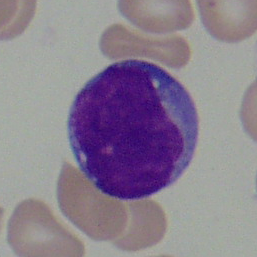

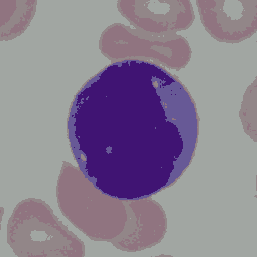

fitness =  622085.8896036836
PSNR =  34.52211454229928
end 1 image


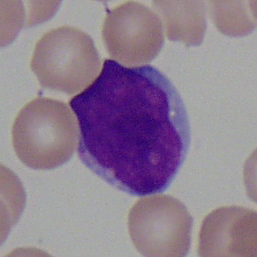

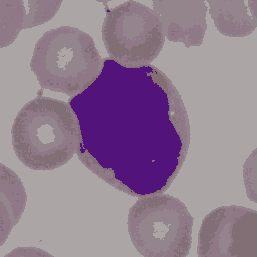

fitness =  713743.0617537897
PSNR =  34.01186026820989
end 2 image


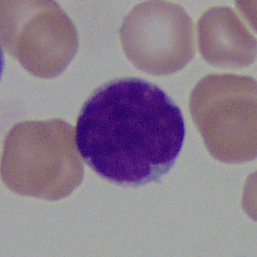

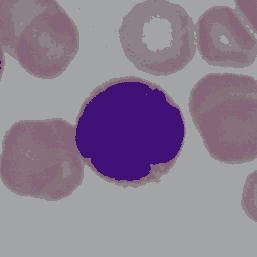

fitness =  654499.1039456634
PSNR =  34.21928623647944
end 3 image


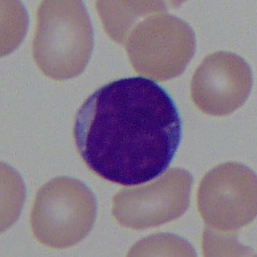

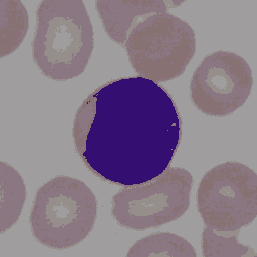

fitness =  613359.7684735986
PSNR =  35.55887452774247
end 4 image


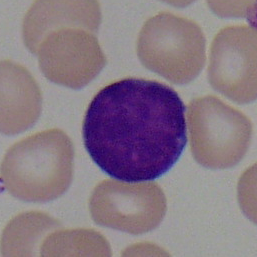

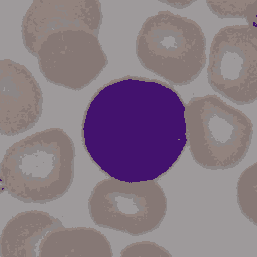

fitness =  618219.8079399182
PSNR =  34.57954627648321
end 5 image


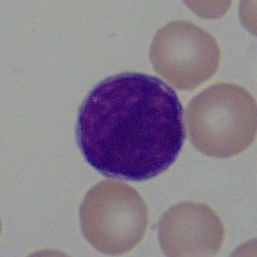

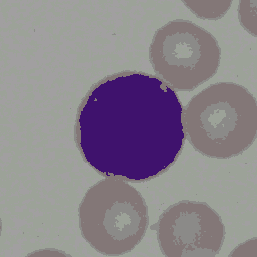

fitness =  598665.451995143
PSNR =  34.43494212114961
end 6 image


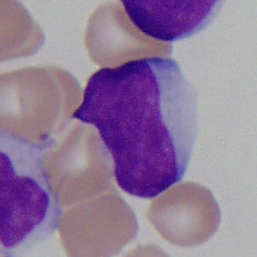

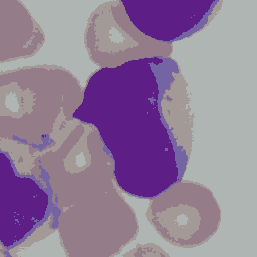

fitness =  929108.4121585446
PSNR =  31.936552701434458
end 7 image


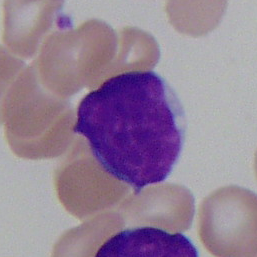

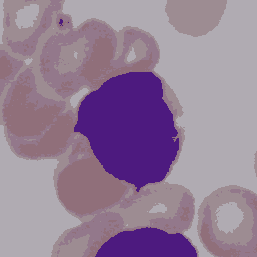

fitness =  774445.7744189287
PSNR =  32.73369747379255
end 8 image


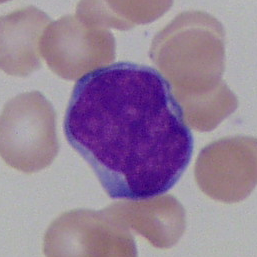

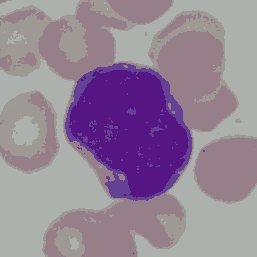

fitness =  790133.6523490931
PSNR =  32.75584682257842
end 9 image


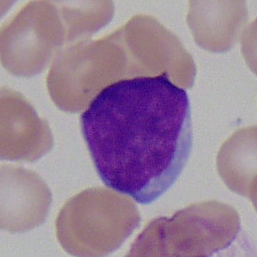

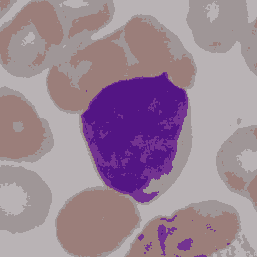

fitness =  924862.0204621886
PSNR =  31.807498003115604
end 10 image


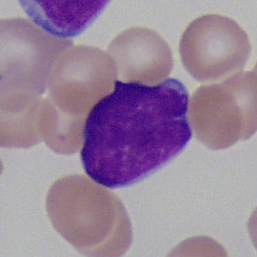

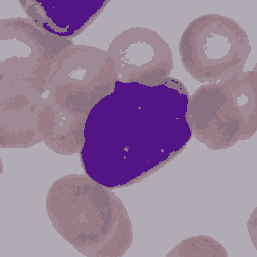

fitness =  858241.4996813049
PSNR =  31.864161307757847
end 11 image


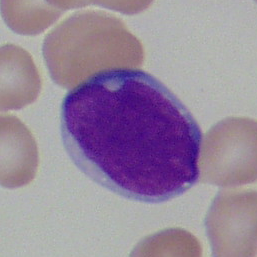

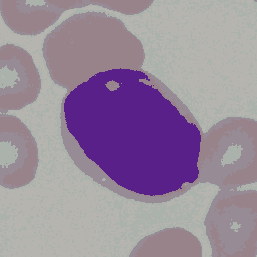

fitness =  772429.2870119908
PSNR =  32.563738632508645
end 12 image


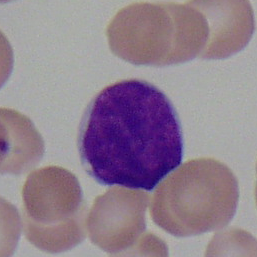

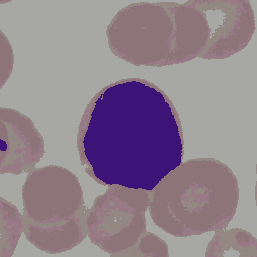

fitness =  714100.13327212
PSNR =  33.853651265191985
end 13 image


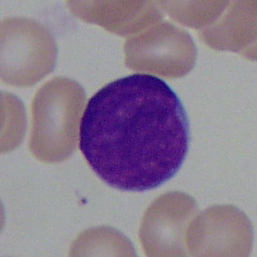

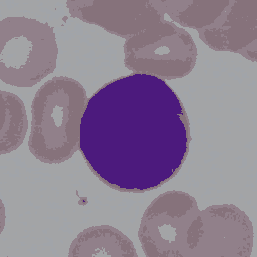

fitness =  659722.5736867113
PSNR =  33.118978572903984
end 14 image


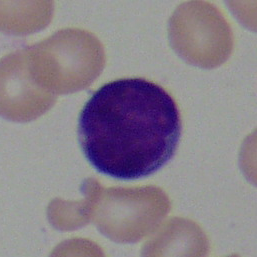

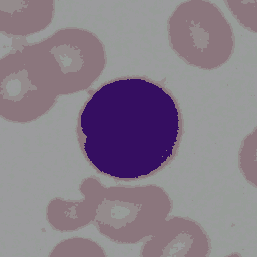

fitness =  585884.2365748094
PSNR =  34.88591656168098
end 15 image


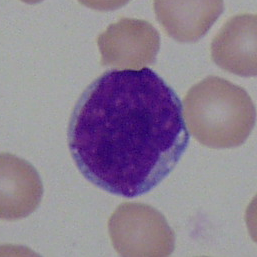

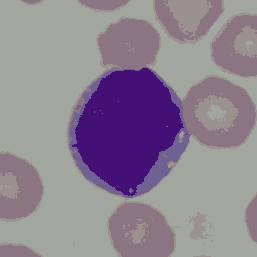

fitness =  645444.4903087334
PSNR =  34.13208618692615
end 16 image


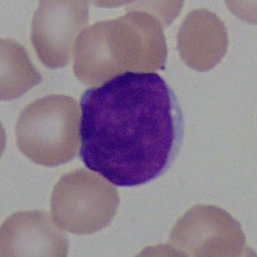

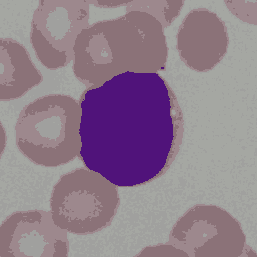

fitness =  659384.9181416815
PSNR =  33.84558838174126
end 17 image


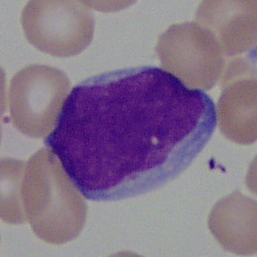

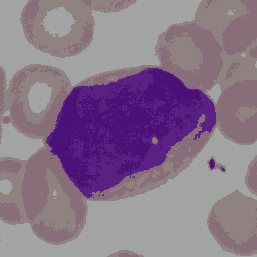

fitness =  730865.661128547
PSNR =  33.593708765598585
end 18 image


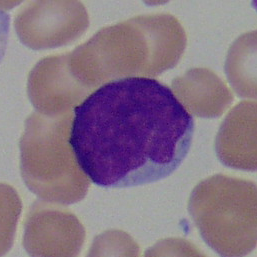

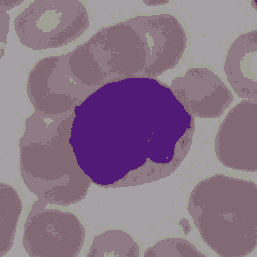

fitness =  748040.0892453572
PSNR =  32.8620344934997
end 19 image


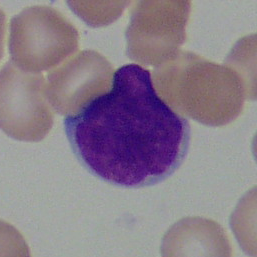

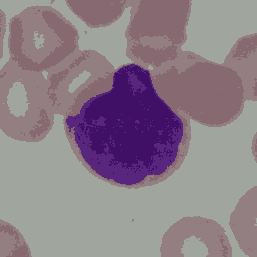

fitness =  676076.574595884
PSNR =  33.583271549017496
end 20 image


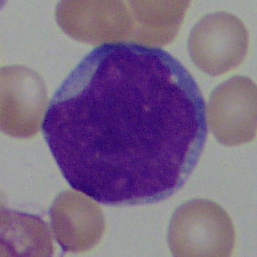

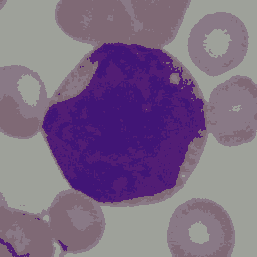

fitness =  793524.4356651511
PSNR =  32.81968213313223
end 21 image


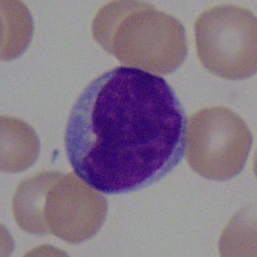

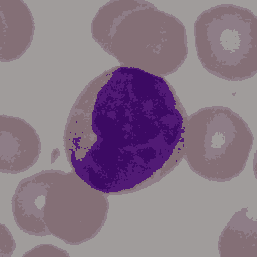

fitness =  674984.5657939729
PSNR =  34.11736983859227
end 22 image


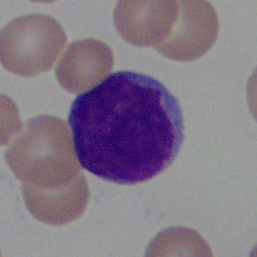

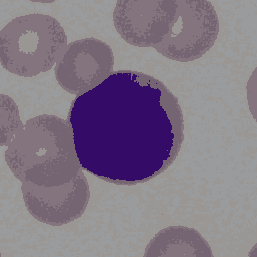

fitness =  631302.0625435881
PSNR =  34.36251428993525
end 23 image


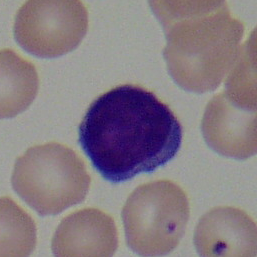

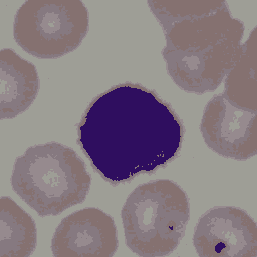

fitness =  652913.6086924941
PSNR =  35.03174338968393
end 24 image


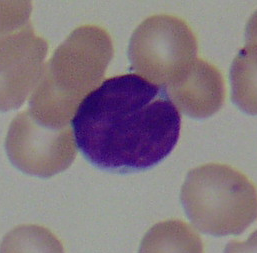

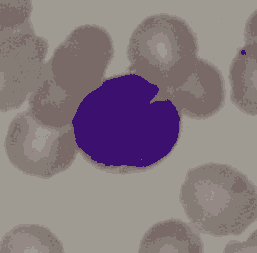

fitness =  741205.3927602511
PSNR =  34.777620706023136
end 25 image


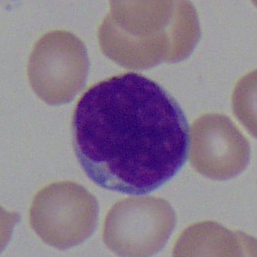

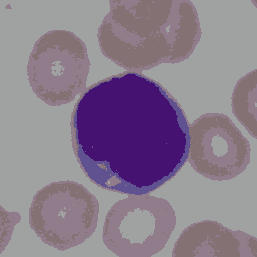

fitness =  626444.2585515281
PSNR =  33.91153178997976
end 26 image


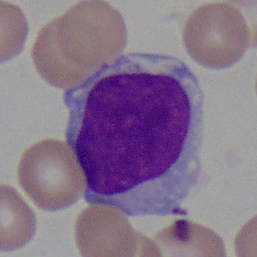

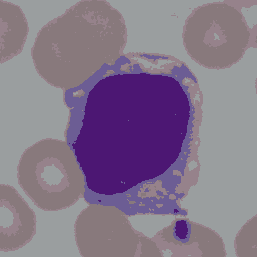

fitness =  785948.1742381281
PSNR =  32.76145396452571
end 27 image


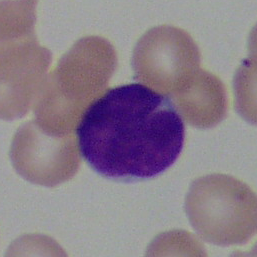

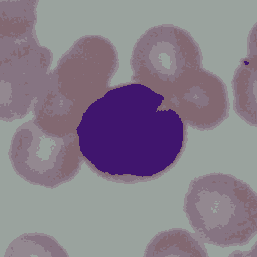

fitness =  660614.7214606234
PSNR =  34.93345124701009
end 28 image


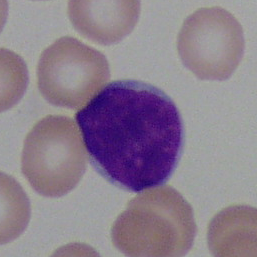

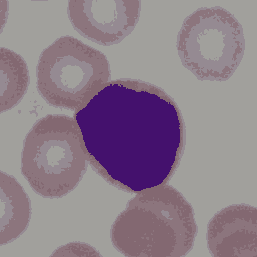

fitness =  617879.0649261719
PSNR =  35.02029429178365
end 29 image


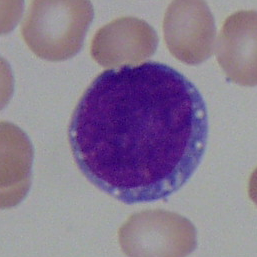

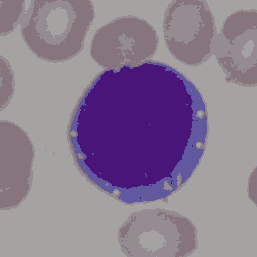

fitness =  674398.7502590651
PSNR =  33.646000331296285
end 30 image


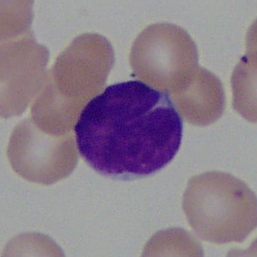

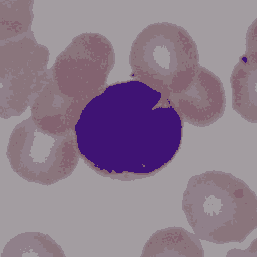

fitness =  648221.223595272
PSNR =  34.03785595579778
end 31 image


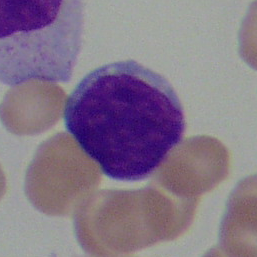

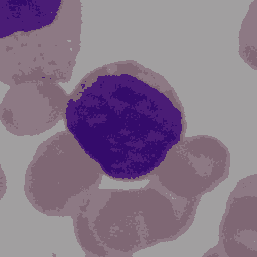

fitness =  778709.3822963617
PSNR =  33.77953403657928
end 32 image


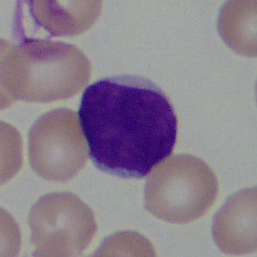

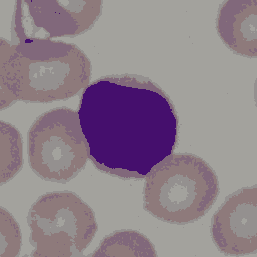

fitness =  663426.6339046381
PSNR =  34.86557926727383
end 33 image


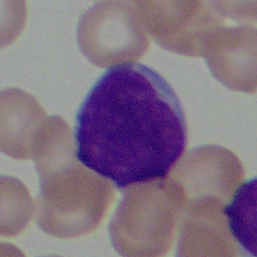

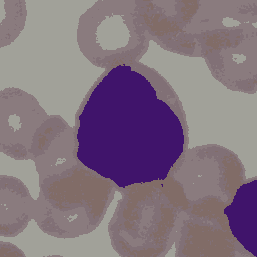

fitness =  761164.8889323458
PSNR =  33.09842367008307
end 34 image


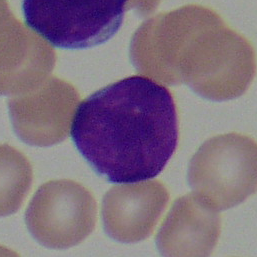

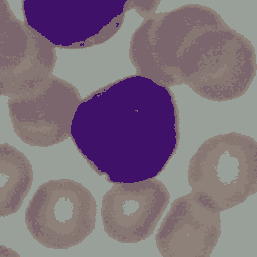

fitness =  784494.2159248032
PSNR =  33.916930781880254
end 35 image


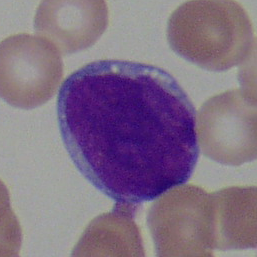

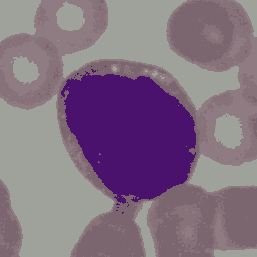

fitness =  766409.246456301
PSNR =  33.34259743367748
end 36 image


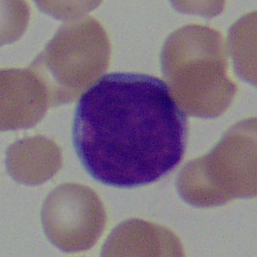

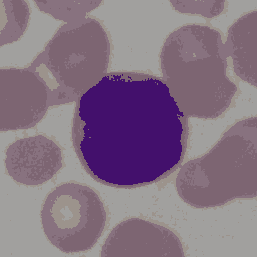

fitness =  760206.1386060454
PSNR =  33.24121626690851
end 37 image


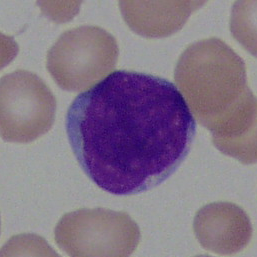

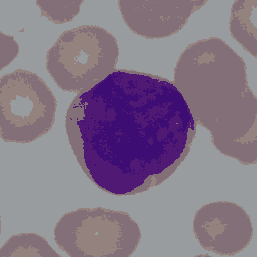

fitness =  702274.5414820604
PSNR =  34.24521880248788
end 38 image


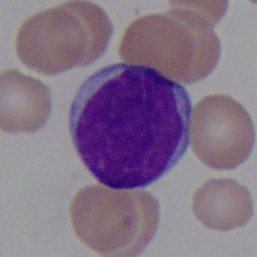

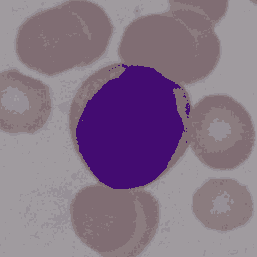

fitness =  704742.2260406995
PSNR =  33.73111217495887
end 39 image


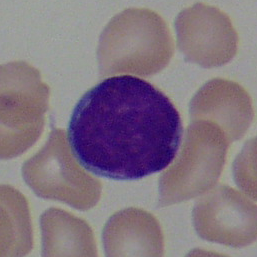

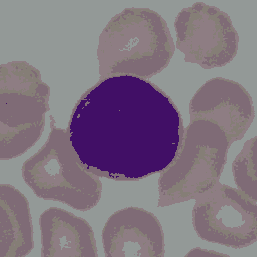

fitness =  732417.671926751
PSNR =  34.07415338332891
end 40 image


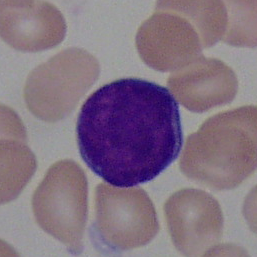

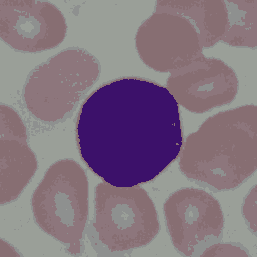

fitness =  683929.2392360197
PSNR =  34.059156499461835
end 41 image


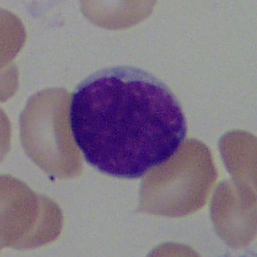

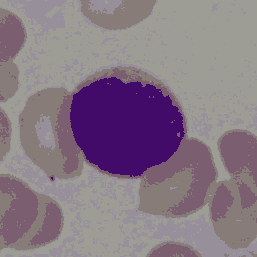

fitness =  730660.1393261813
PSNR =  33.99290037416211
end 42 image


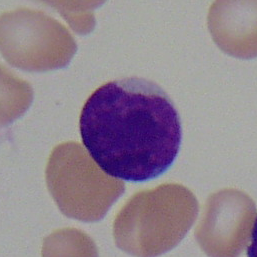

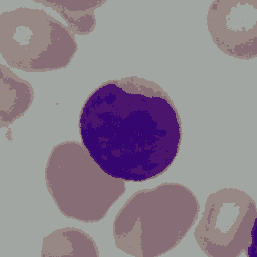

fitness =  674561.9857299917
PSNR =  34.30897659024304
end 43 image


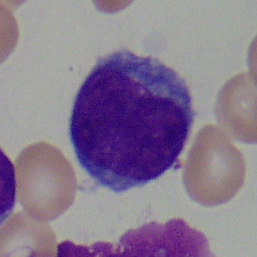

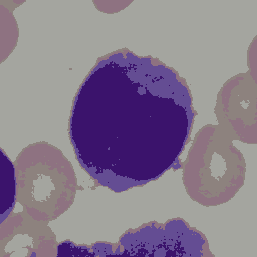

fitness =  781953.1905584553
PSNR =  33.14587271836086
end 44 image


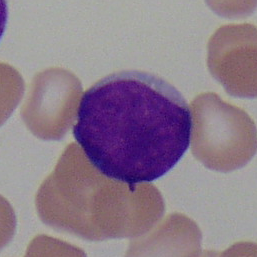

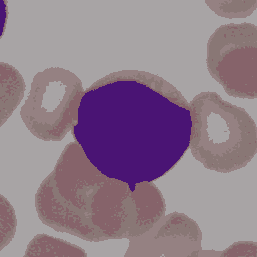

fitness =  689502.8779579215
PSNR =  33.99549273234695
end 45 image


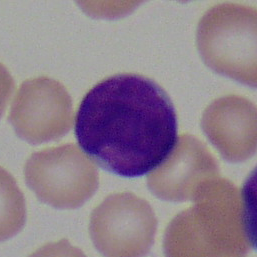

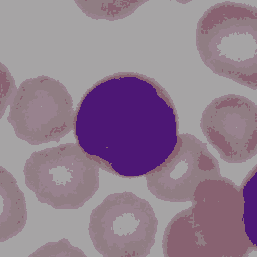

fitness =  729526.4814032862
PSNR =  32.86913225469567
end 46 image


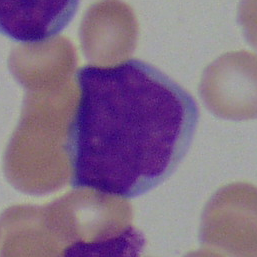

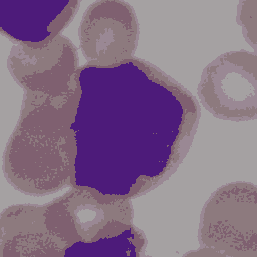

fitness =  828238.4716511616
PSNR =  32.44999391776694
end 47 image


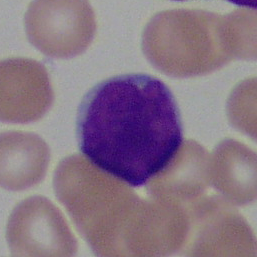

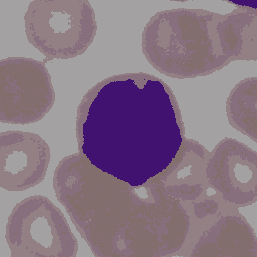

fitness =  699035.9927032272
PSNR =  33.52086939015199
end 48 image


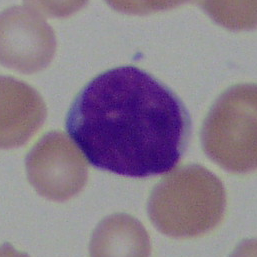

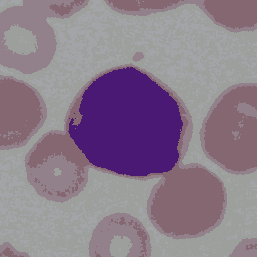

fitness =  674944.9355773127
PSNR =  33.29649505765203
end 49 image


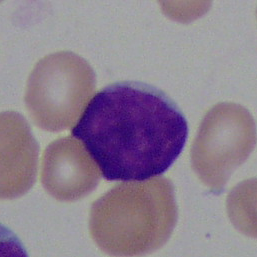

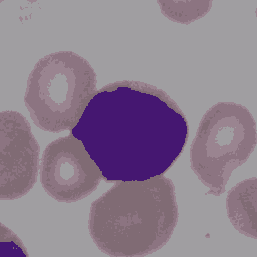

fitness =  638684.3367319982
PSNR =  34.125178284630195
end 50 image


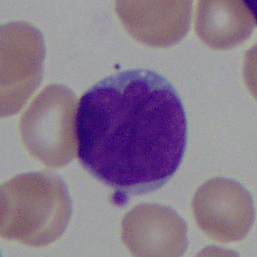

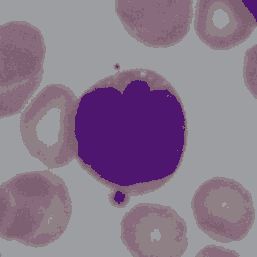

fitness =  708837.0810849908
PSNR =  33.73349358663366
end 51 image


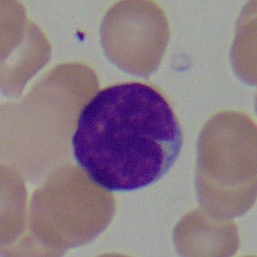

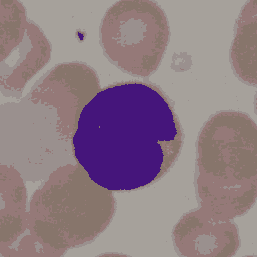

fitness =  749668.643408002
PSNR =  34.52541555236053
end 52 image


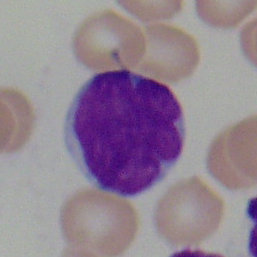

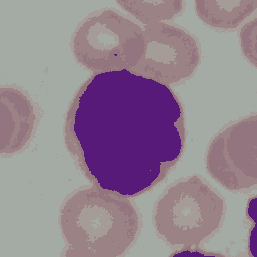

fitness =  726715.8788753771
PSNR =  34.20622186483499
end 53 image


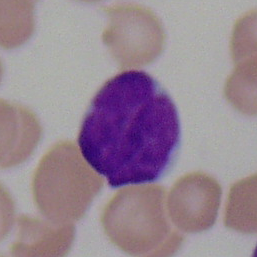

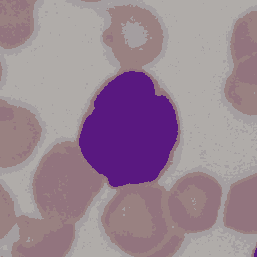

fitness =  681813.3564470711
PSNR =  34.07059397562942
end 54 image


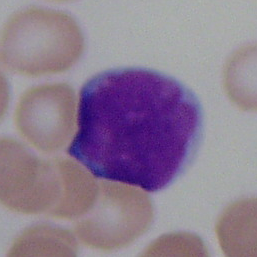

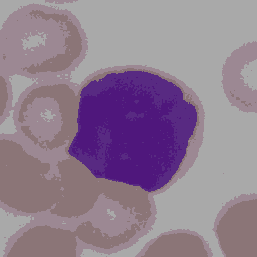

fitness =  765916.5959243462
PSNR =  32.40509591383577
end 55 image


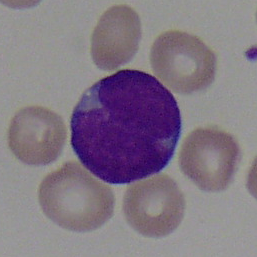

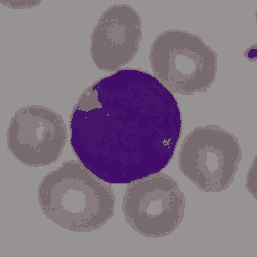

fitness =  554400.97297812
PSNR =  35.57040089520253
end 56 image


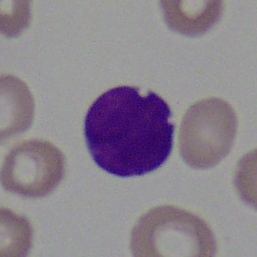

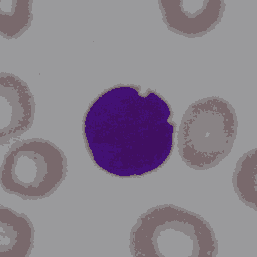

fitness =  535565.4772786762
PSNR =  35.2351503959357
end 57 image


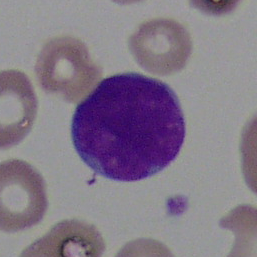

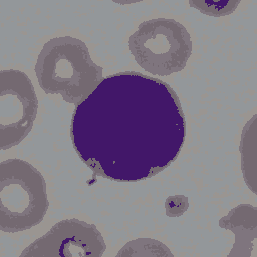

fitness =  654599.2393062399
PSNR =  33.87846923548159
end 58 image


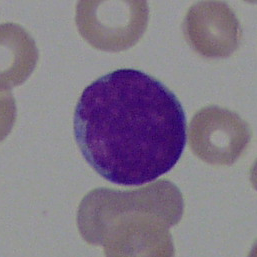

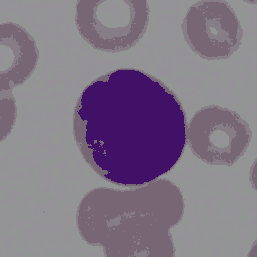

fitness =  552012.366810198
PSNR =  34.46864004930182
end 59 image


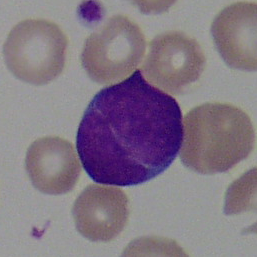

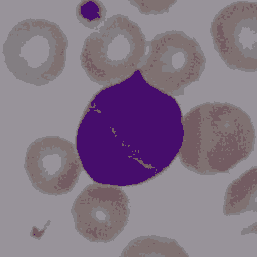

fitness =  710971.4158362553
PSNR =  33.75865981362453
end 60 image


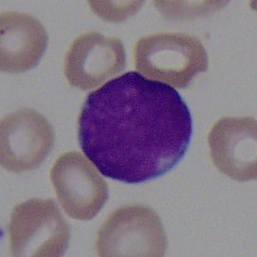

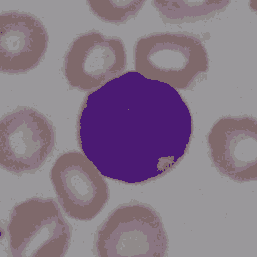

fitness =  647356.062904146
PSNR =  34.26513868391071
end 61 image


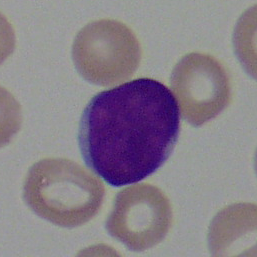

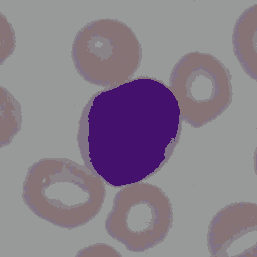

fitness =  562373.2974060694
PSNR =  34.832035417314785
end 62 image


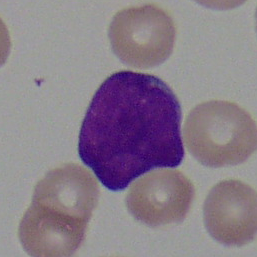

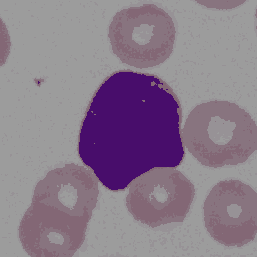

fitness =  569049.8452481591
PSNR =  34.98677537917403
end 63 image


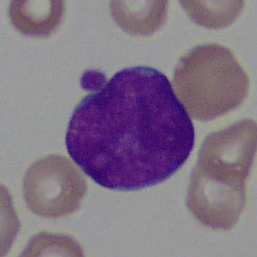

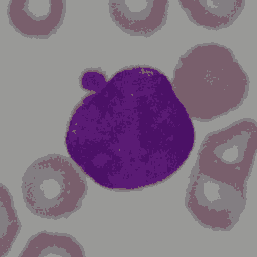

fitness =  631406.6968828082
PSNR =  33.81955944270749
end 64 image


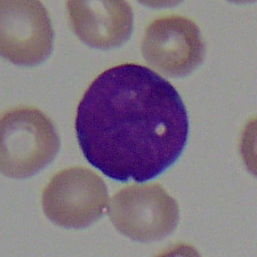

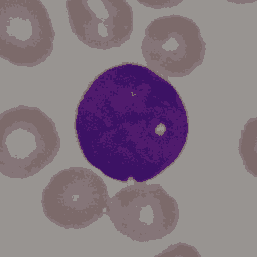

fitness =  649590.1238723679
PSNR =  34.490703096229126
end 65 image


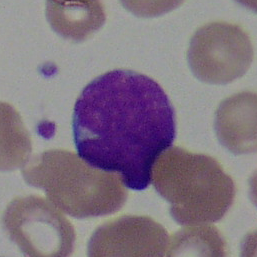

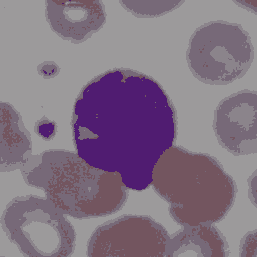

fitness =  782951.8829106104
PSNR =  32.9519606525631
end 66 image


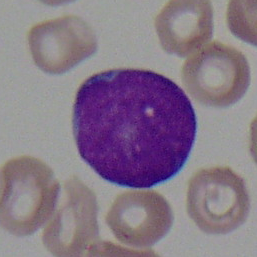

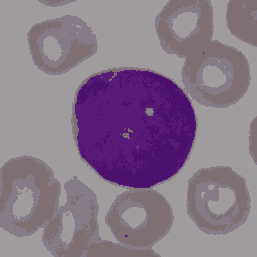

fitness =  718958.5163100606
PSNR =  33.27655868586449
end 67 image


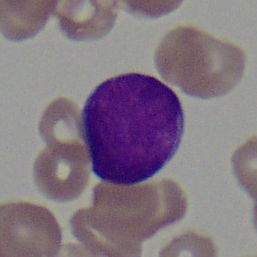

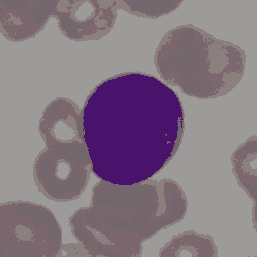

fitness =  669918.6595661057
PSNR =  33.407012411364676
end 68 image


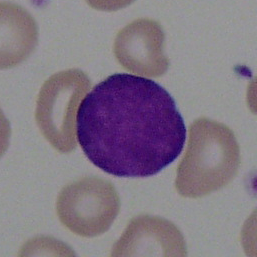

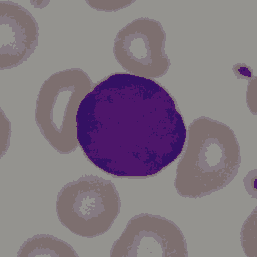

fitness =  587424.4980983699
PSNR =  35.431858479135585
end 69 image


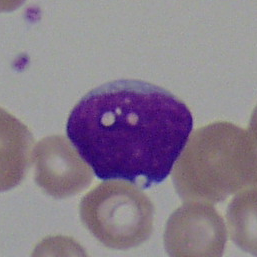

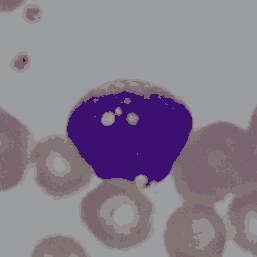

fitness =  625939.6730637983
PSNR =  34.79728586052551
end 70 image


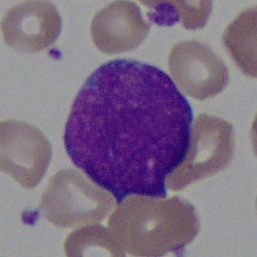

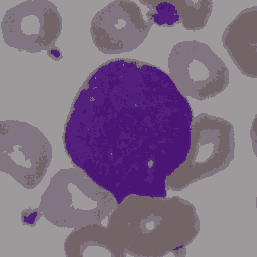

fitness =  737032.9851666937
PSNR =  33.02059138742901
end 71 image


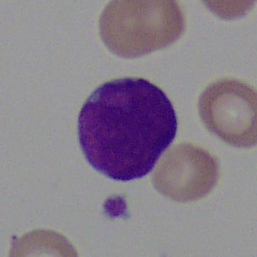

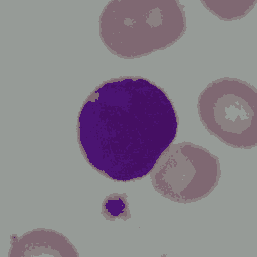

fitness =  554820.3838299371
PSNR =  35.53333669346488
end 72 image


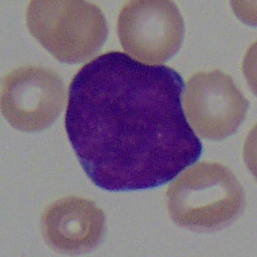

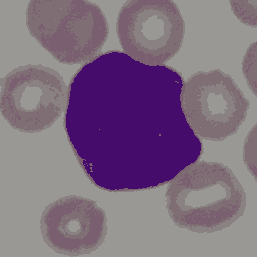

fitness =  628910.4706400767
PSNR =  35.00149298145181
end 73 image


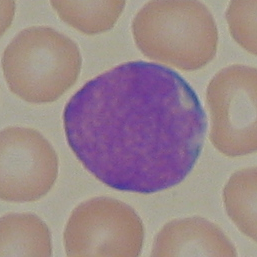

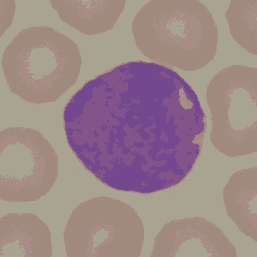

fitness =  576130.0117644216
PSNR =  35.334965577068225
end 74 image


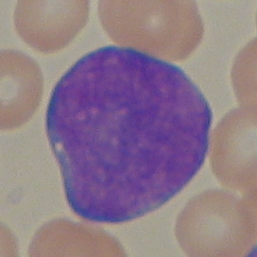

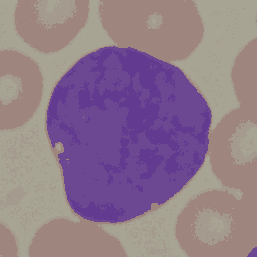

fitness =  605957.4458291086
PSNR =  34.91768233826229
end 75 image


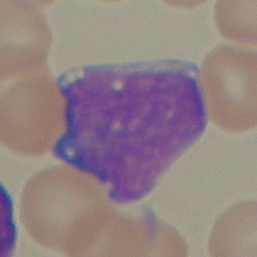

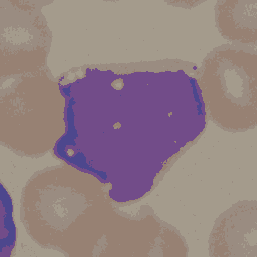

fitness =  593779.2513611121
PSNR =  34.620749460903
end 76 image


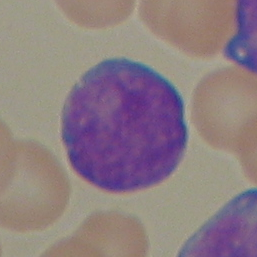

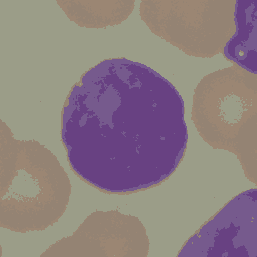

fitness =  636800.4104315374
PSNR =  35.122490497356445
end 77 image


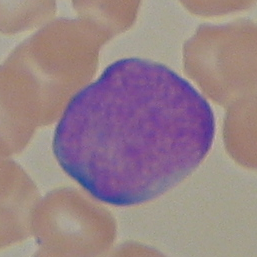

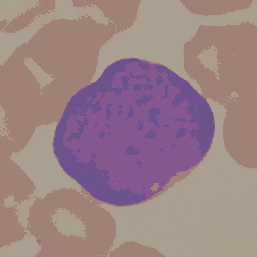

fitness =  670841.5145609027
PSNR =  33.59525366895843
end 78 image


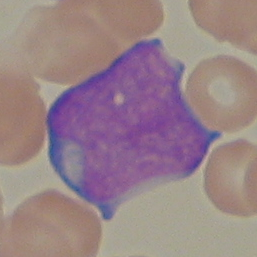

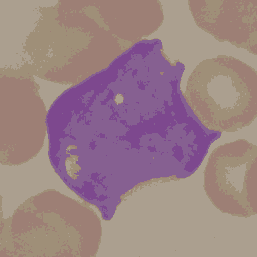

fitness =  677092.596513551
PSNR =  35.04996704966734
end 79 image


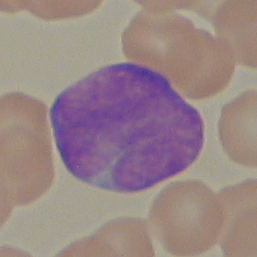

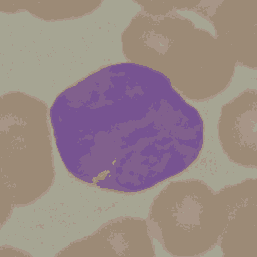

fitness =  571473.639420328
PSNR =  34.96271073198595
end 80 image


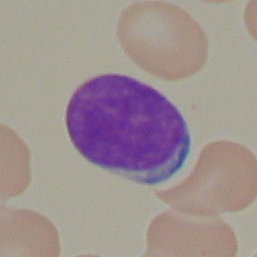

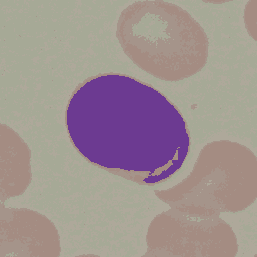

fitness =  465262.911056301
PSNR =  36.67824470846794
end 81 image


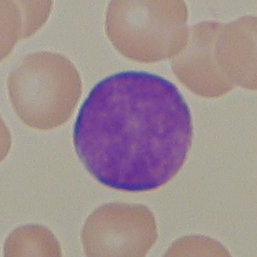

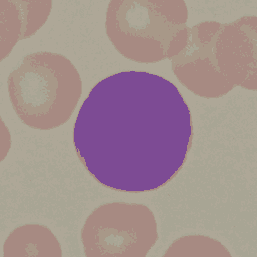

fitness =  533250.9594574443
PSNR =  35.13052620289787
end 82 image


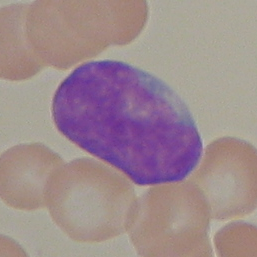

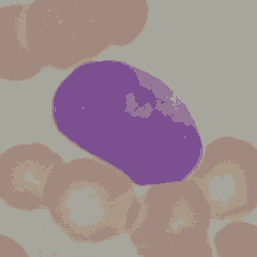

fitness =  575730.622338837
PSNR =  34.519511897367266
end 83 image


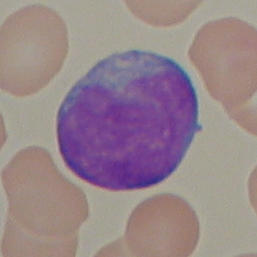

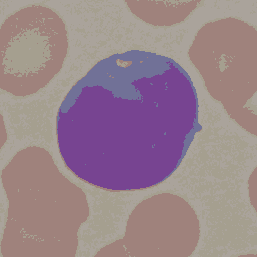

fitness =  628116.5631592784
PSNR =  33.87006177358985
end 84 image


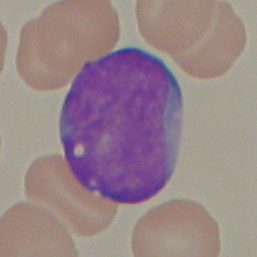

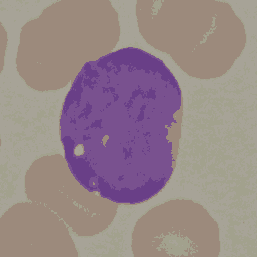

fitness =  582490.7299814062
PSNR =  34.940011441438386
end 85 image


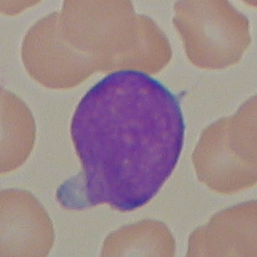

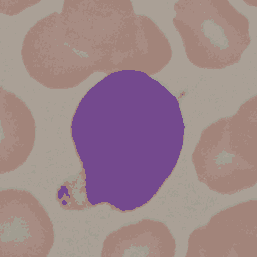

fitness =  551257.2652238394
PSNR =  35.407497180796746
end 86 image


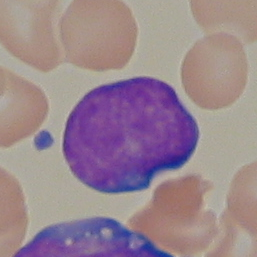

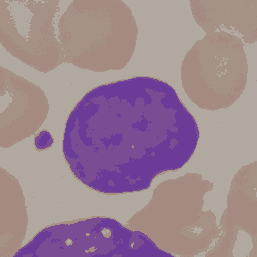

fitness =  756483.4143374835
PSNR =  33.59562333355553
end 87 image


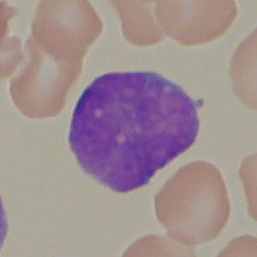

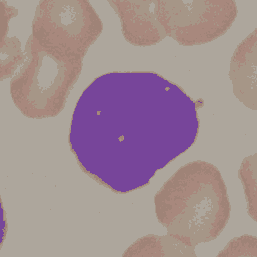

fitness =  535627.219970666
PSNR =  35.52888709229396
end 88 image


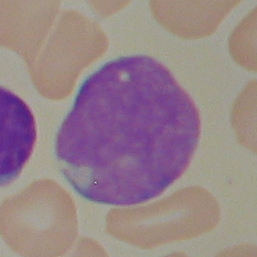

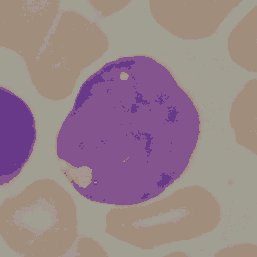

fitness =  581705.3743747884
PSNR =  34.238299123714654
end 89 image


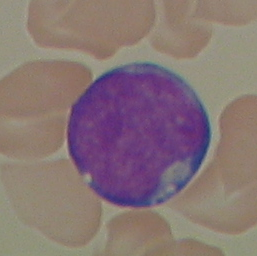

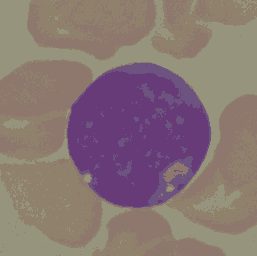

fitness =  588988.6625760039
PSNR =  35.72070180598577
end 90 image


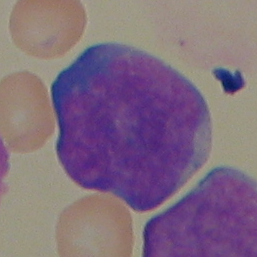

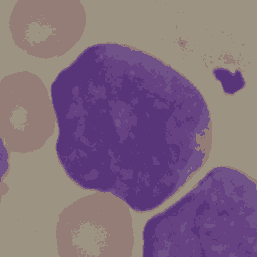

fitness =  708507.8582696682
PSNR =  34.90028334360809
end 91 image


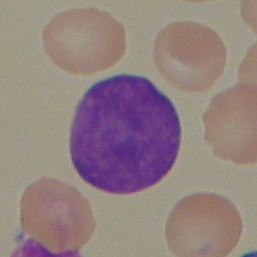

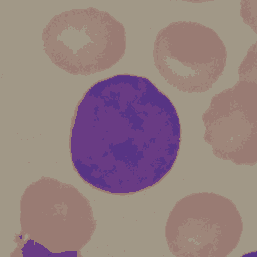

fitness =  504798.2967873421
PSNR =  36.71228237769361
end 92 image


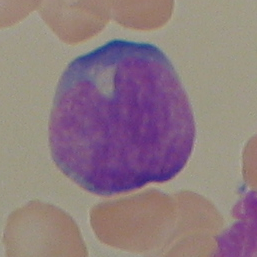

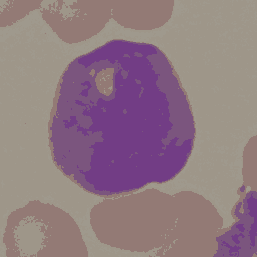

fitness =  665370.5032422871
PSNR =  34.36363767743718
end 93 image


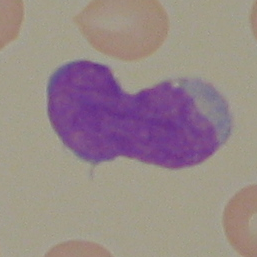

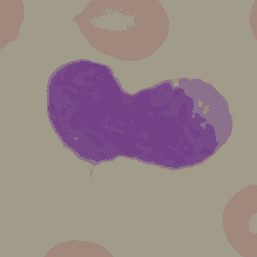

fitness =  388354.56919002114
PSNR =  37.42235123387454
end 94 image


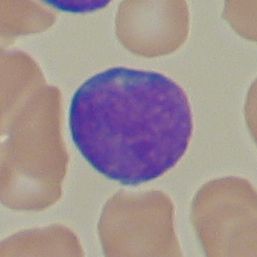

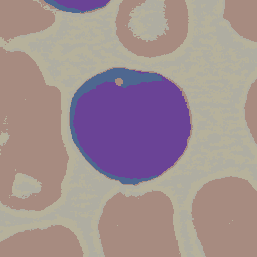

fitness =  669805.4523122432
PSNR =  33.177645039365885
end 95 image


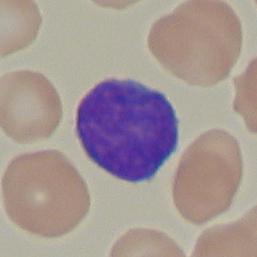

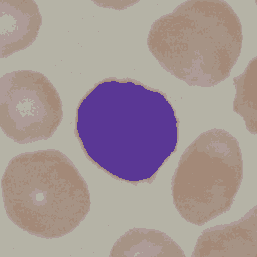

fitness =  551942.4081639551
PSNR =  35.79570871693428
end 96 image


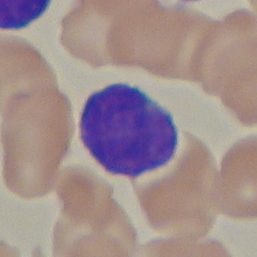

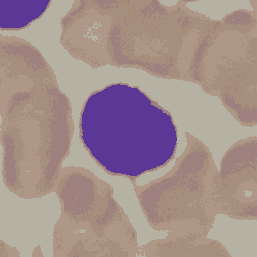

fitness =  645755.7144616409
PSNR =  34.78977364957376
end 97 image


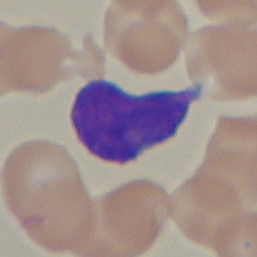

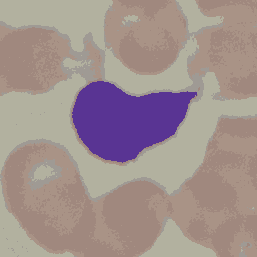

fitness =  579467.8331680937
PSNR =  35.16431426049255
end 98 image


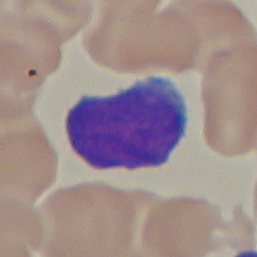

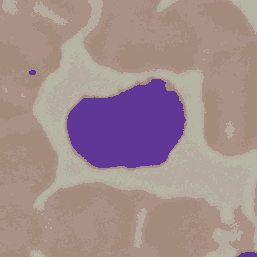

fitness =  613092.9861785022
PSNR =  34.944288092259086
end 99 image


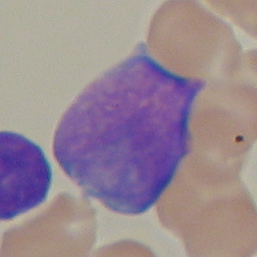

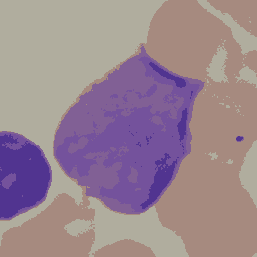

fitness =  681969.4998970719
PSNR =  32.99699356855325
end 100 image


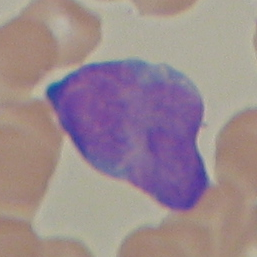

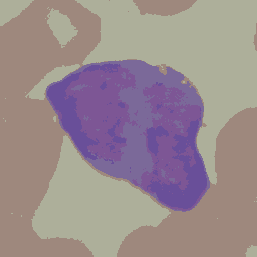

fitness =  654158.2607502532
PSNR =  33.95401751115233
end 101 image


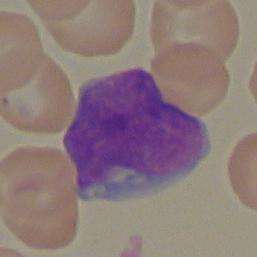

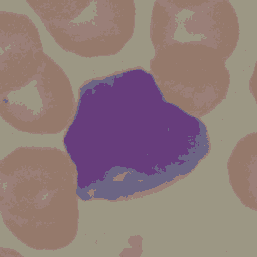

fitness =  560117.0927504805
PSNR =  34.91777262186477
end 102 image


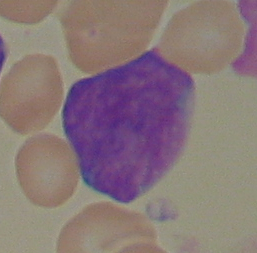

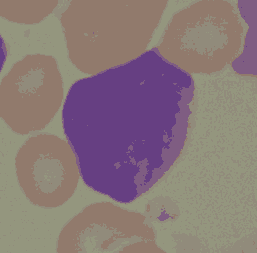

fitness =  580631.5714903111
PSNR =  34.88246583616189
end 103 image


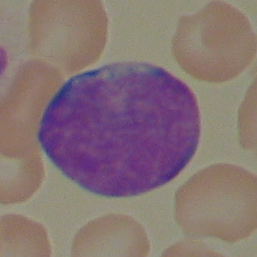

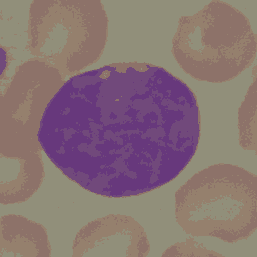

fitness =  552330.233553659
PSNR =  36.284013476793
end 104 image


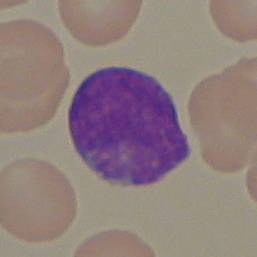

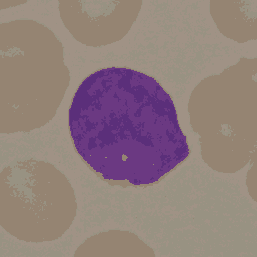

fitness =  518827.24021222355
PSNR =  35.90728682398645
end 105 image


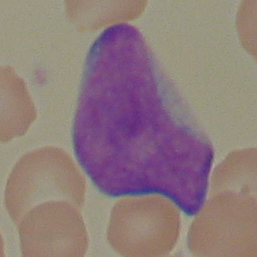

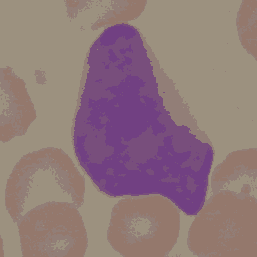

fitness =  595968.4888524141
PSNR =  34.94540647659925
end 106 image


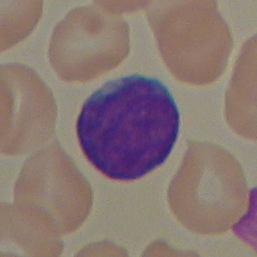

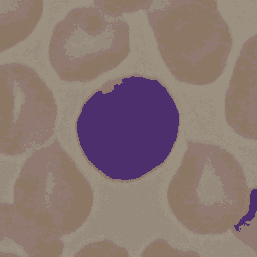

fitness =  570330.4096174765
PSNR =  36.38421409336355
end 107 image


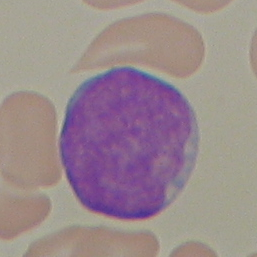

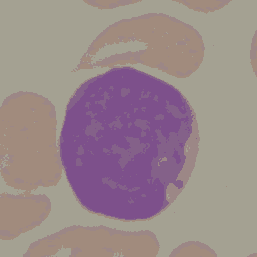

fitness =  539942.2665351805
PSNR =  35.258285187148495
end 108 image


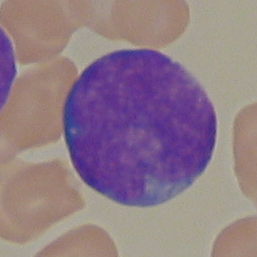

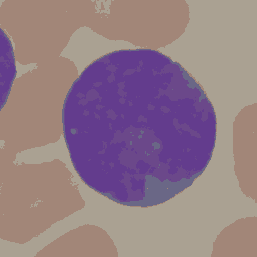

fitness =  592759.3480562846
PSNR =  34.32786796177808
end 109 image


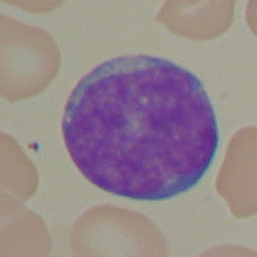

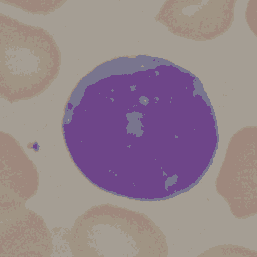

fitness =  569520.672253452
PSNR =  34.54896776133261
end 110 image


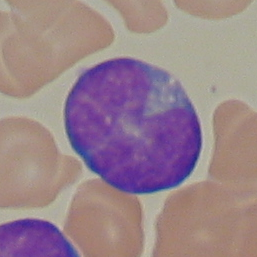

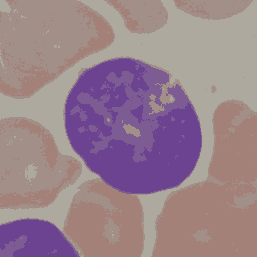

fitness =  701628.1449969555
PSNR =  33.91096633436311
end 111 image


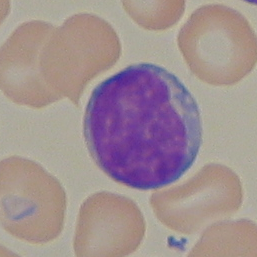

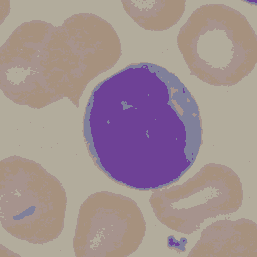

fitness =  605748.1923172871
PSNR =  33.99812442565248
end 112 image


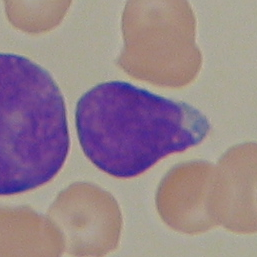

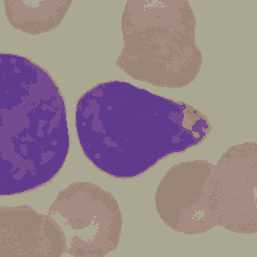

fitness =  613666.0870337712
PSNR =  34.84166114180116
end 113 image


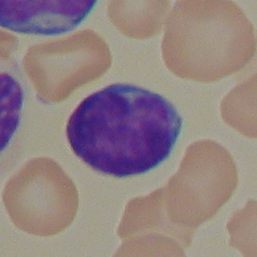

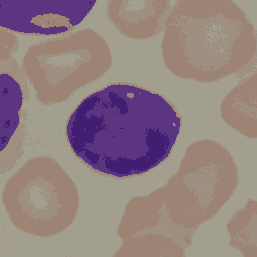

fitness =  623840.4106081851
PSNR =  34.33228670957044
end 114 image


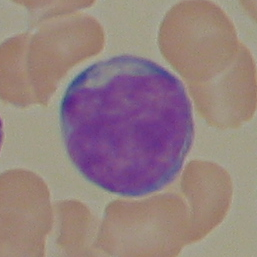

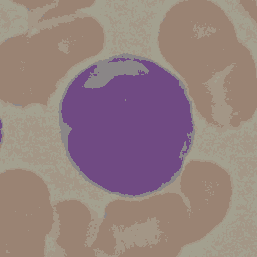

fitness =  587048.4960474267
PSNR =  34.51326169483095
end 115 image


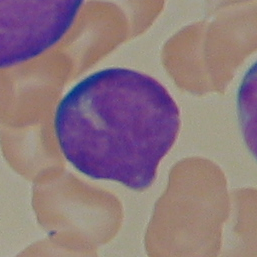

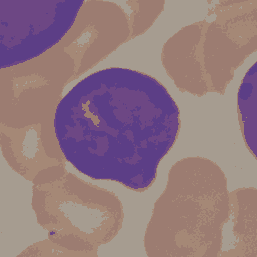

fitness =  745150.121891899
PSNR =  34.35825627639342
end 116 image


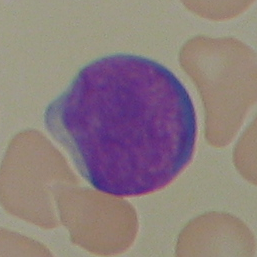

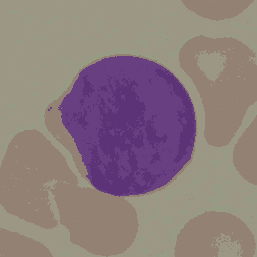

fitness =  552982.0689484759
PSNR =  35.45748865111153
end 117 image


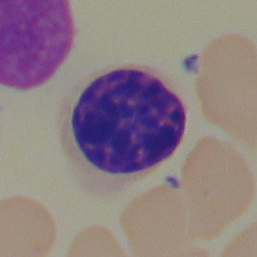

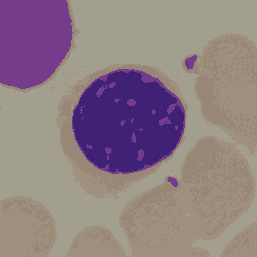

fitness =  592038.5303153014
PSNR =  34.72613079332448
end 118 image


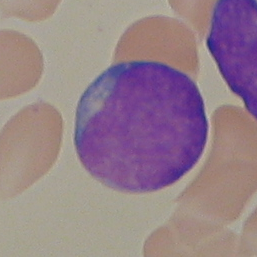

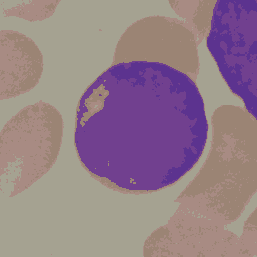

fitness =  686844.3921961964
PSNR =  34.07805439924828
end 119 image


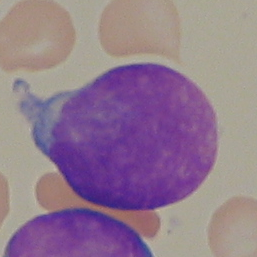

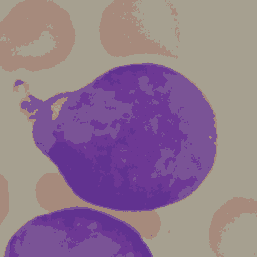

fitness =  812636.1882032581
PSNR =  32.78042336776251
end 120 image


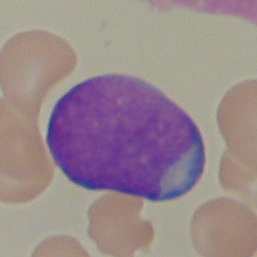

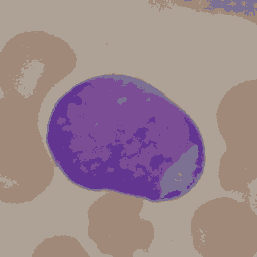

fitness =  703848.2359213516
PSNR =  34.16719480977372
end 121 image


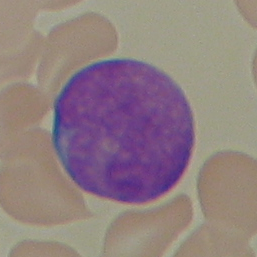

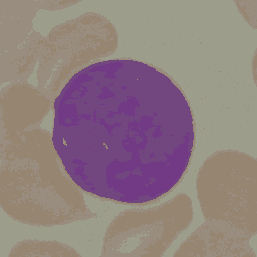

fitness =  573824.7067861987
PSNR =  35.82611023874928
end 122 image


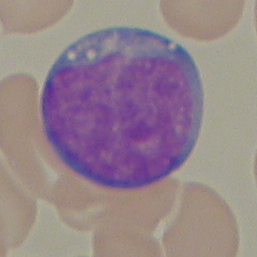

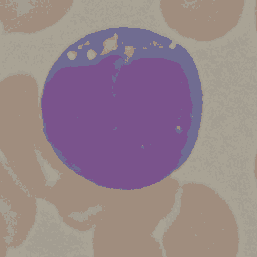

fitness =  594045.061338565
PSNR =  34.07569182715278
end 123 image


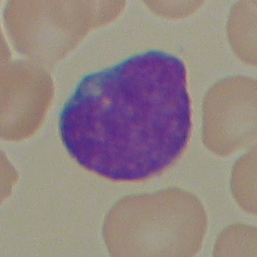

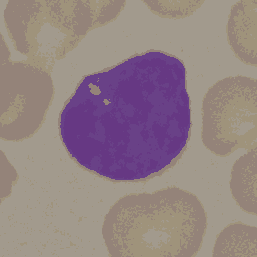

fitness =  572107.1789104113
PSNR =  36.2229084310106
end 124 image


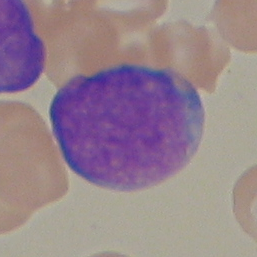

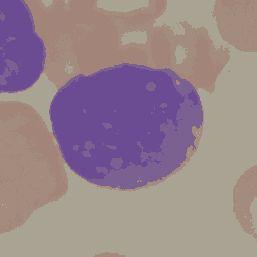

fitness =  673362.3511145053
PSNR =  34.021663876624054
end 125 image


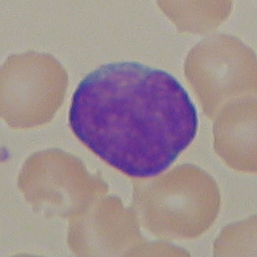

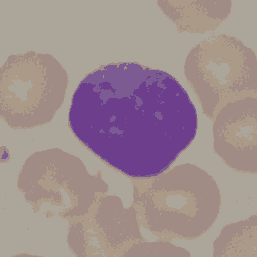

fitness =  514744.32429726375
PSNR =  35.795617260203166
end 126 image


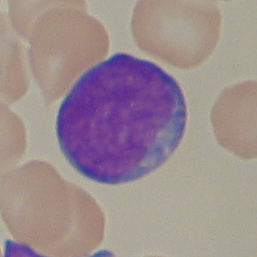

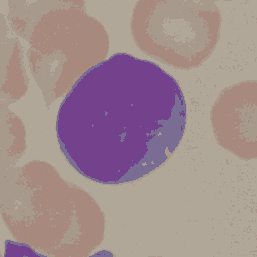

fitness =  616789.2698572084
PSNR =  34.896706553750015
end 127 image


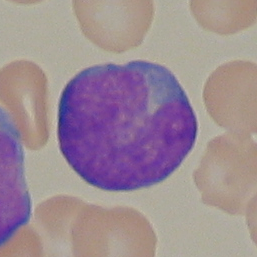

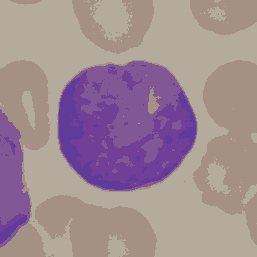

fitness =  692108.1175007949
PSNR =  33.46300875729633
end 128 image


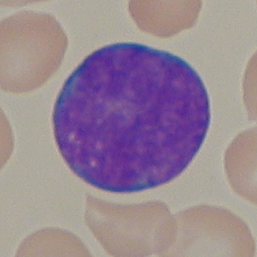

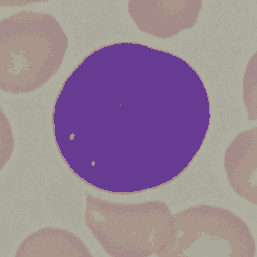

fitness =  553989.9012490369
PSNR =  35.49163746529598
end 129 image


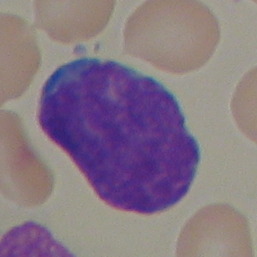

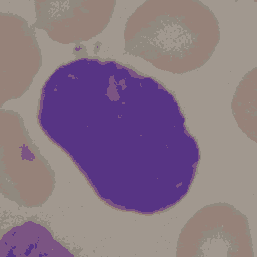

fitness =  647485.3757908968
PSNR =  34.01451454474029
end 130 image


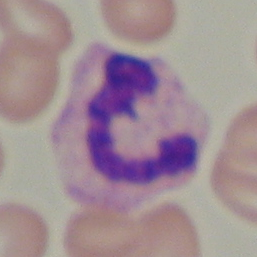

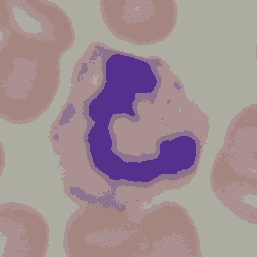

fitness =  652981.702703304
PSNR =  34.06629275485714
end 131 image


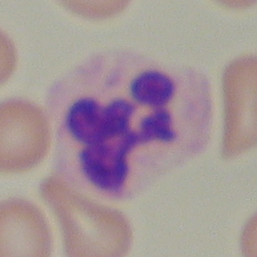

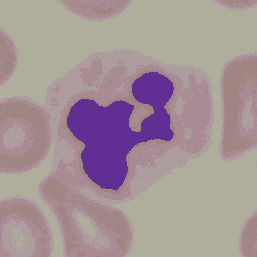

fitness =  629486.2080847255
PSNR =  35.3474755846992
end 132 image


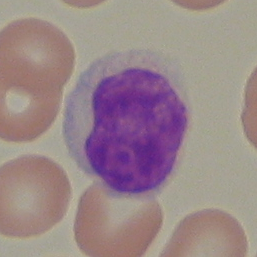

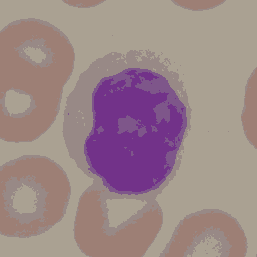

fitness =  620100.7254049466
PSNR =  33.988816146250784
end 133 image


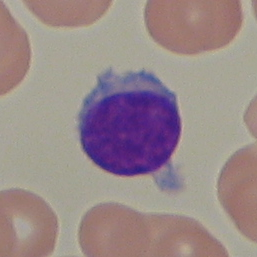

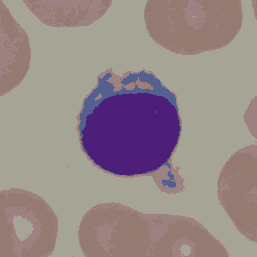

fitness =  584555.9274562536
PSNR =  35.011123613961715
end 134 image


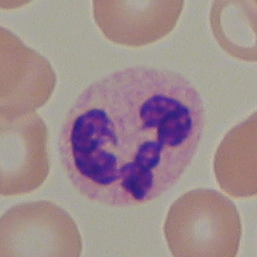

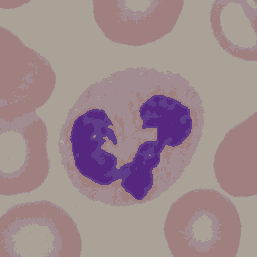

fitness =  643732.7625629242
PSNR =  34.39590674455806
end 135 image


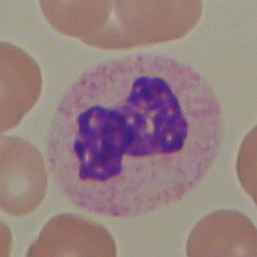

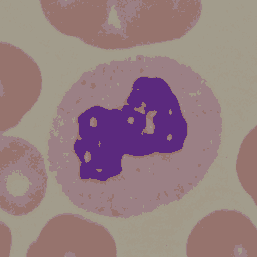

fitness =  618154.1316127945
PSNR =  34.22852327066244
end 136 image


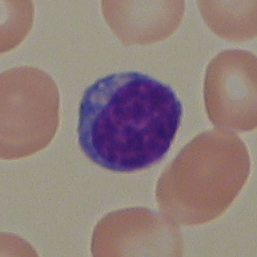

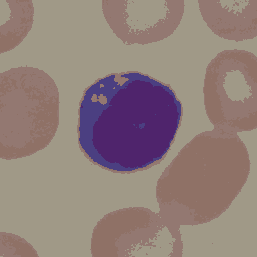

fitness =  605046.9312796649
PSNR =  33.77876755240697
end 137 image


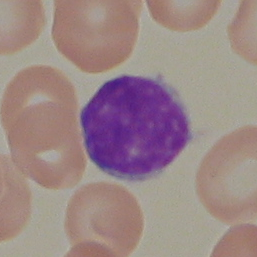

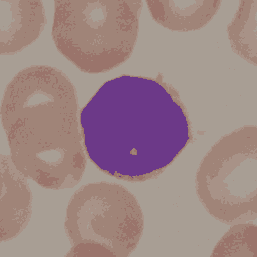

fitness =  555559.0753554619
PSNR =  35.050541584807384
end 138 image


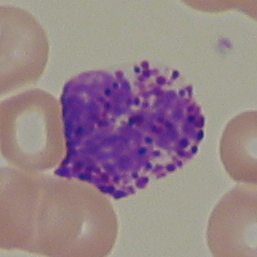

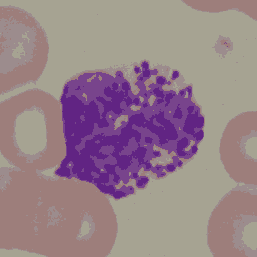

fitness =  640603.8892789986
PSNR =  33.93890721965338
end 139 image


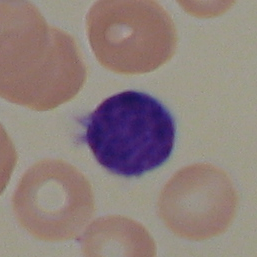

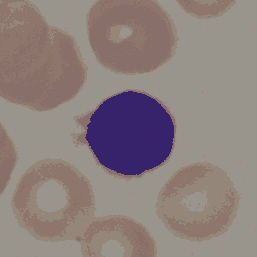

fitness =  559431.5432103435
PSNR =  35.94612507449646
end 140 image


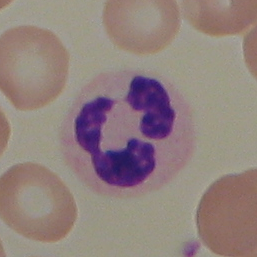

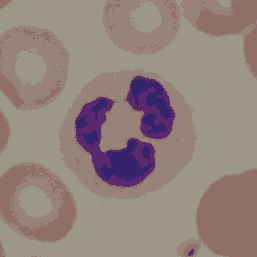

fitness =  575999.6765098363
PSNR =  35.30520349612816
end 141 image


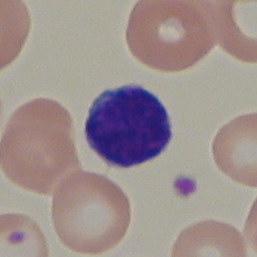

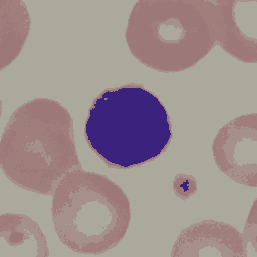

fitness =  535556.8174306575
PSNR =  35.823363452695716
end 142 image


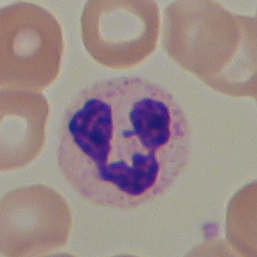

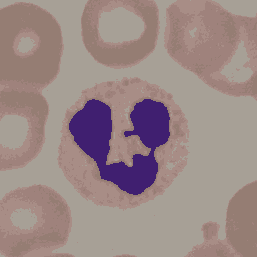

fitness =  694413.9899236759
PSNR =  34.4473729165899
end 143 image


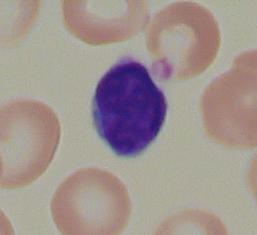

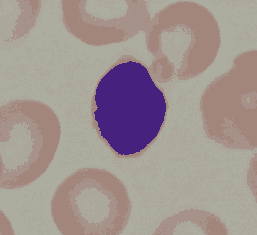

fitness =  485141.94845690054
PSNR =  35.884582774720336
end 144 image


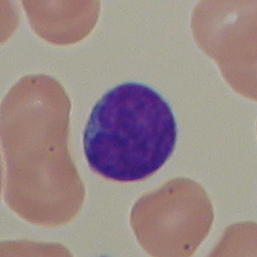

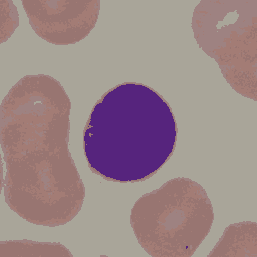

fitness =  526378.0304759971
PSNR =  35.73491293714597
end 145 image


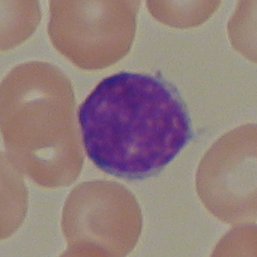

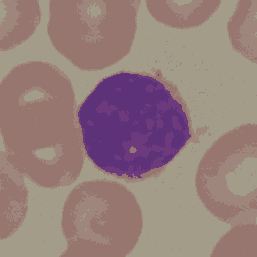

fitness =  597096.4008782294
PSNR =  34.58829011826856
end 146 image


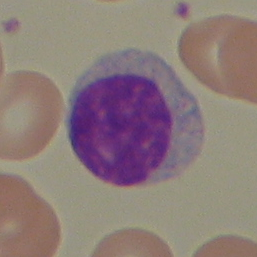

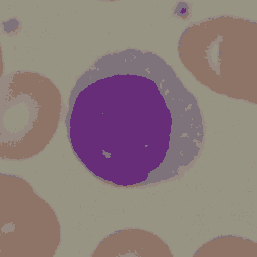

fitness =  557370.4054544359
PSNR =  35.249609894020665
end 147 image


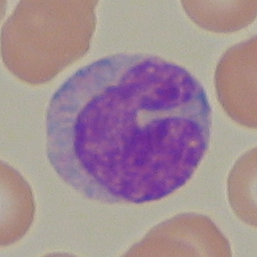

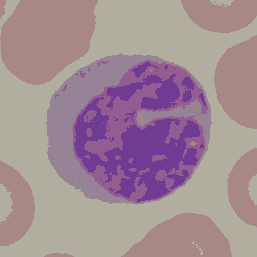

fitness =  661565.1930456483
PSNR =  32.97925145871572
end 148 image


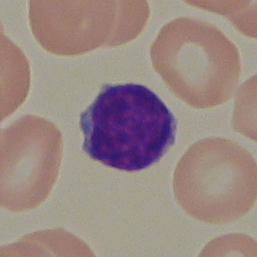

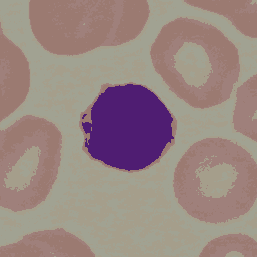

fitness =  517776.62950274575
PSNR =  35.94940463489034
end 149 image


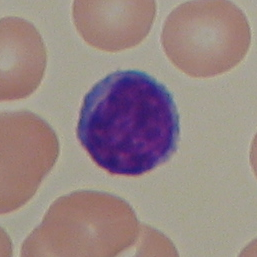

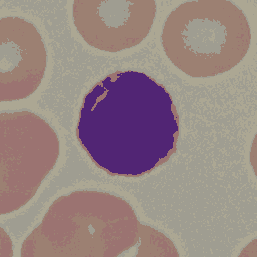

fitness =  662889.6136807341
PSNR =  34.63919568065617
end 150 image


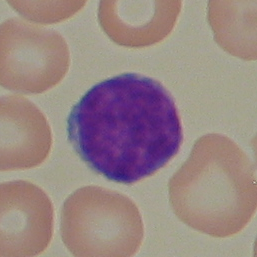

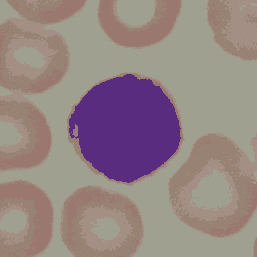

fitness =  624402.4005992638
PSNR =  34.953623051848766
end 151 image


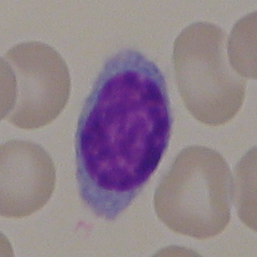

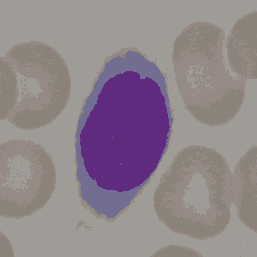

fitness =  538307.4995469517
PSNR =  35.33847298018676
end 152 image


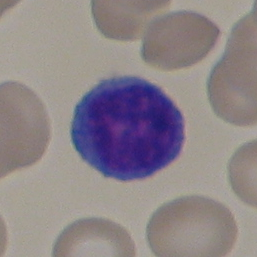

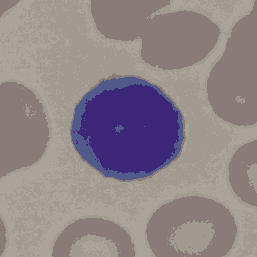

fitness =  597615.2142446075
PSNR =  33.62139819114172
end 153 image


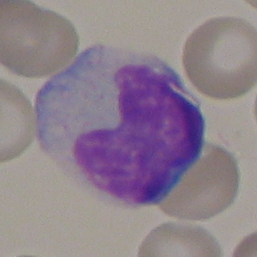

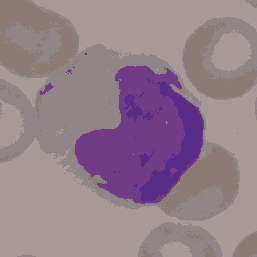

fitness =  736460.6131657066
PSNR =  34.02174492765673
end 154 image


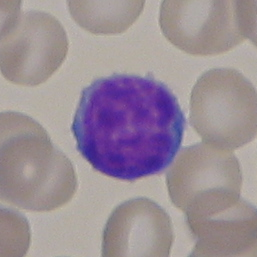

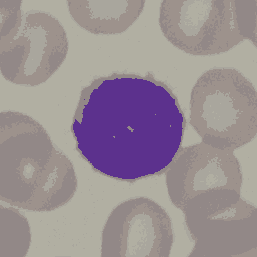

fitness =  663470.6344073229
PSNR =  34.321493855864766
end 155 image


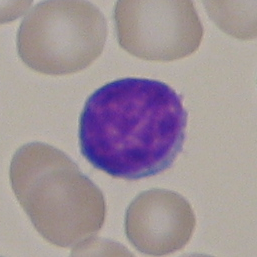

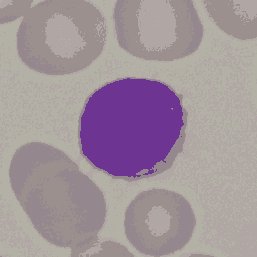

fitness =  656431.3407107316
PSNR =  34.37005477399995
end 156 image


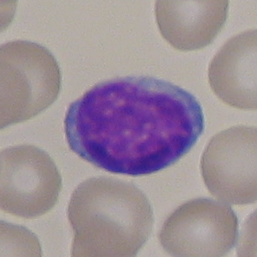

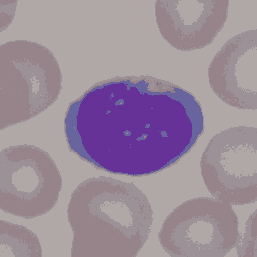

fitness =  697785.5148820208
PSNR =  33.33442773038409
end 157 image


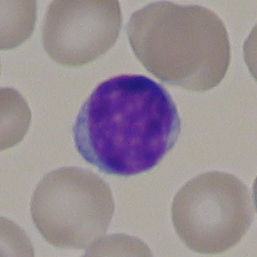

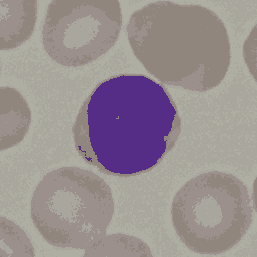

fitness =  602255.3879497453
PSNR =  34.5796499577862
end 158 image


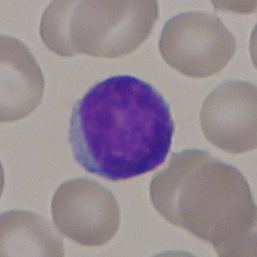

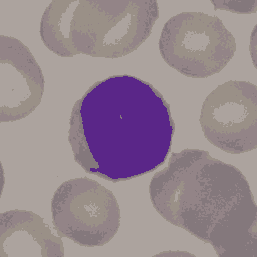

fitness =  618983.7964838782
PSNR =  34.65658299508986
end 159 image


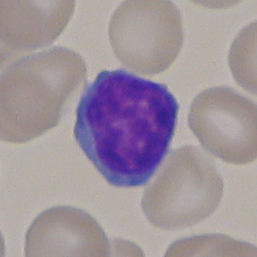

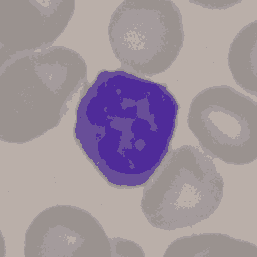

fitness =  587651.4091676497
PSNR =  34.58371852260004
end 160 image


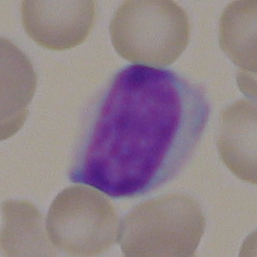

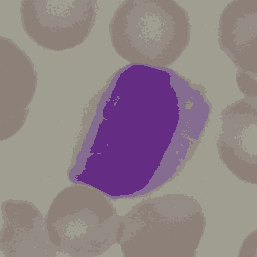

fitness =  605032.3031861794
PSNR =  34.41987265712414
end 161 image


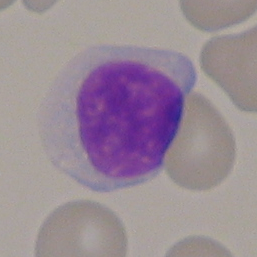

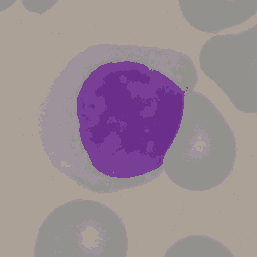

fitness =  615402.0034581282
PSNR =  35.51798138347449
end 162 image


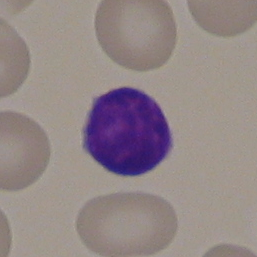

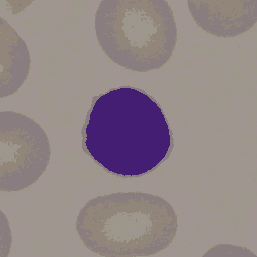

fitness =  437516.210974052
PSNR =  37.376961263667695
end 163 image


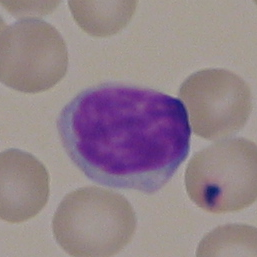

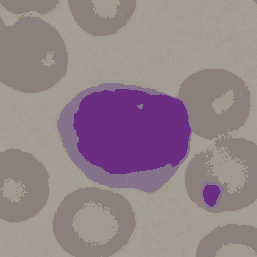

fitness =  592242.8329531023
PSNR =  33.49269024841662
end 164 image


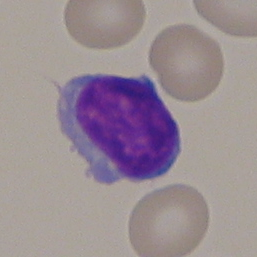

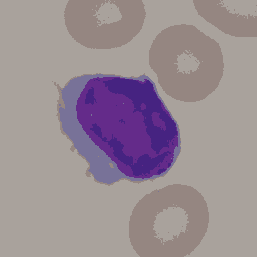

fitness =  456660.07707512483
PSNR =  35.714511184481424
end 165 image


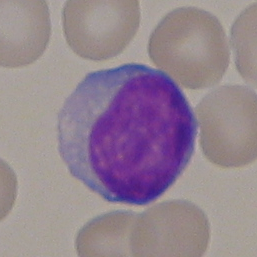

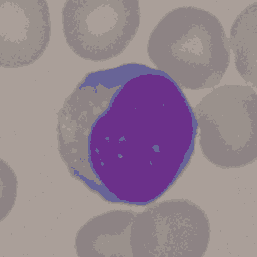

fitness =  601299.1737446119
PSNR =  34.79278846958688
end 166 image


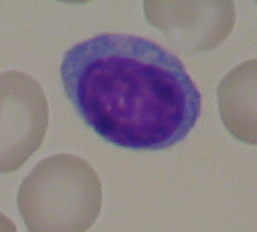

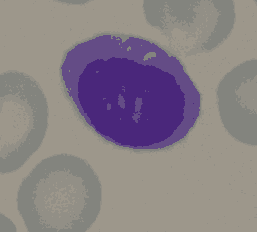

fitness =  527340.7157053829
PSNR =  35.65571928354097
end 167 image


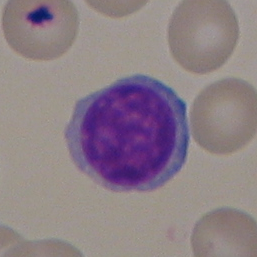

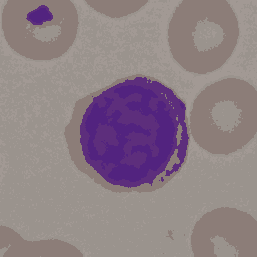

fitness =  578212.9490678126
PSNR =  35.18626563158197
end 168 image


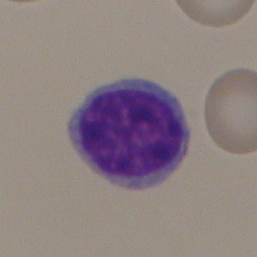

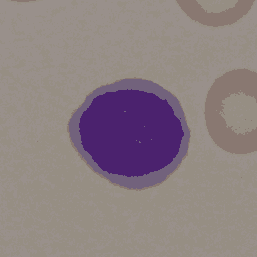

fitness =  427380.7865698317
PSNR =  36.68361785983293
end 169 image


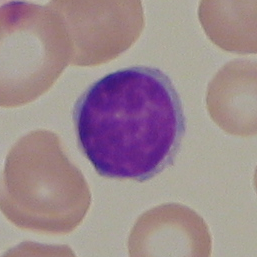

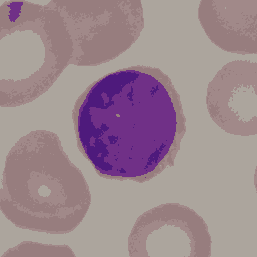

fitness =  606741.4347549328
PSNR =  34.170826446625796
end 170 image


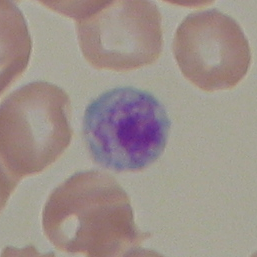

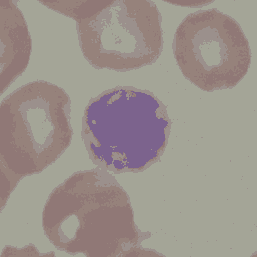

fitness =  548812.1297142664
PSNR =  35.78119123496077
end 171 image


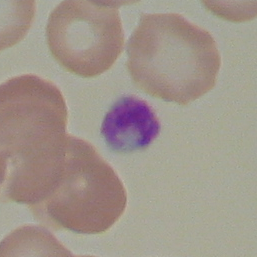

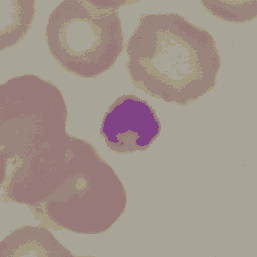

fitness =  493942.0260416685
PSNR =  36.76588551373723
end 172 image


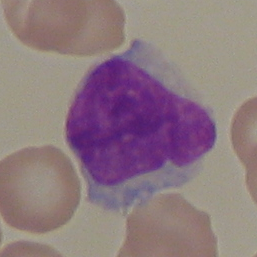

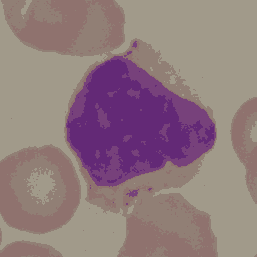

fitness =  579475.3113652411
PSNR =  34.64870721851293
end 173 image


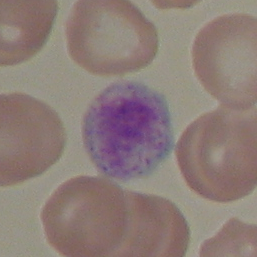

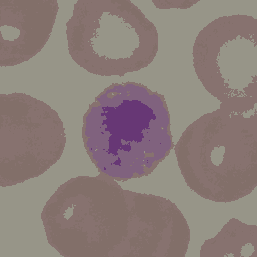

fitness =  589830.9502585989
PSNR =  33.62853677597835
end 174 image


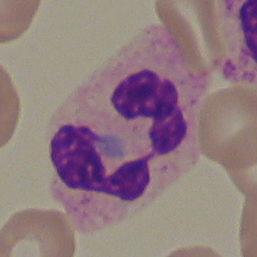

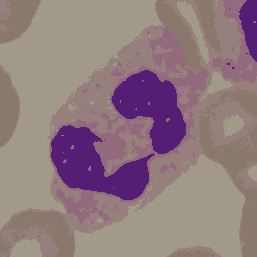

fitness =  642531.0594917153
PSNR =  34.56696738287544
end 175 image


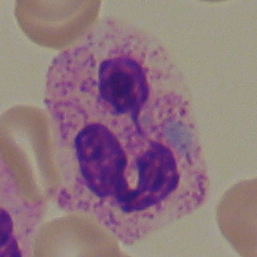

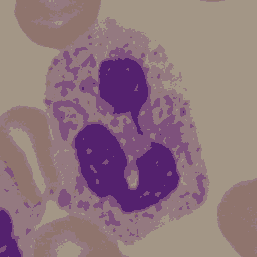

fitness =  743610.7037105986
PSNR =  32.60350432221836
end 176 image


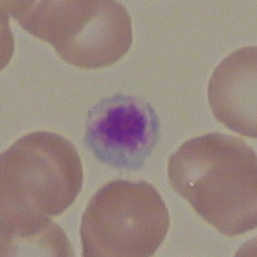

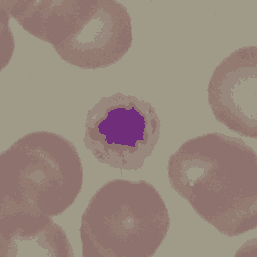

fitness =  470672.5692548695
PSNR =  36.97534852235259
end 177 image


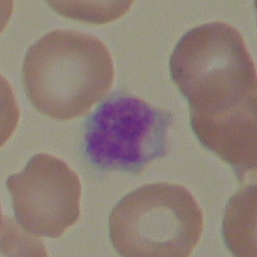

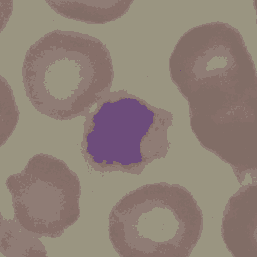

fitness =  538139.1012253152
PSNR =  35.5931166189228
end 178 image


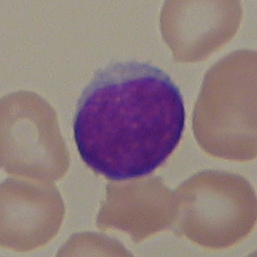

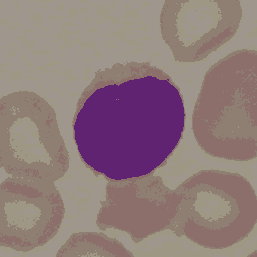

fitness =  596558.9201916985
PSNR =  34.62145893799915
end 179 image


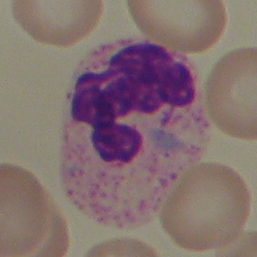

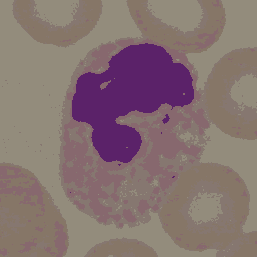

fitness =  693125.3842092801
PSNR =  33.877773300606904
end 180 image


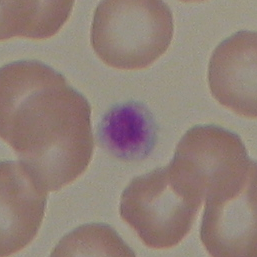

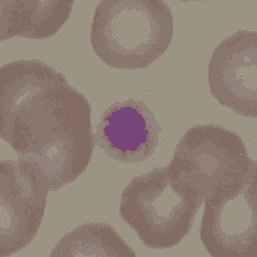

fitness =  478880.4854446084
PSNR =  37.32499548796774
end 181 image


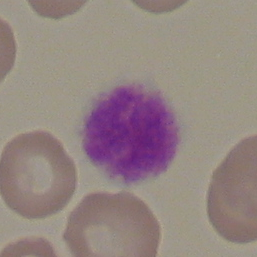

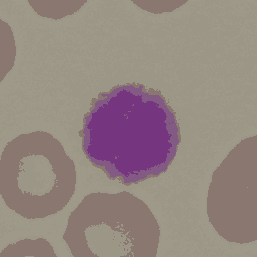

fitness =  433769.2412606905
PSNR =  35.24349479803215
end 182 image


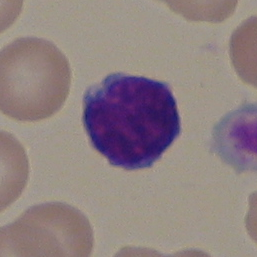

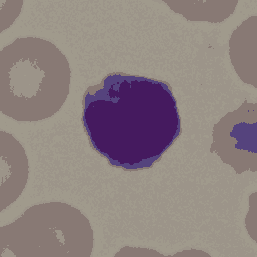

fitness =  526997.8030392493
PSNR =  35.52469981257532
end 183 image


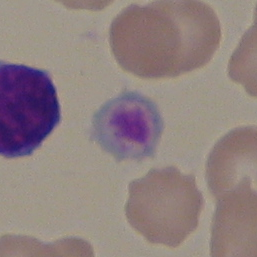

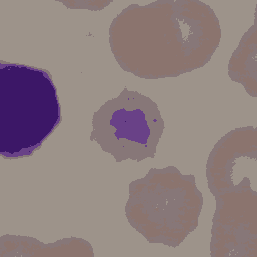

fitness =  553303.3311858948
PSNR =  34.41372253767857
end 184 image


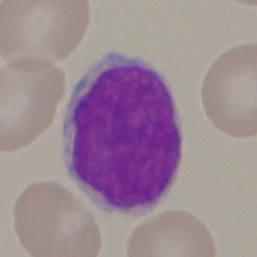

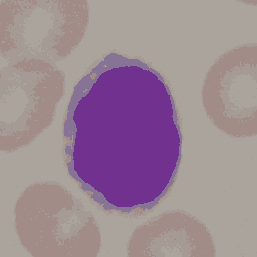

fitness =  467103.92749251256
PSNR =  35.97384038806537
end 185 image


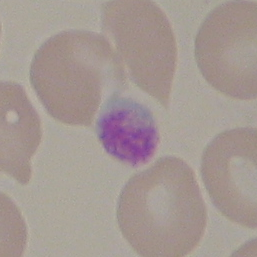

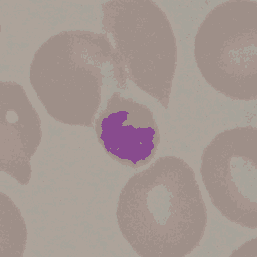

fitness =  356351.0262312877
PSNR =  38.78494833600708
end 186 image


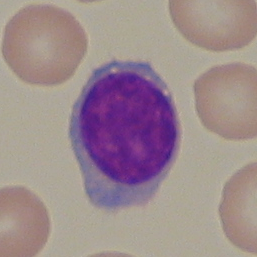

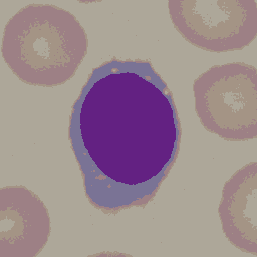

fitness =  538229.0118565079
PSNR =  35.91564251580079
end 187 image


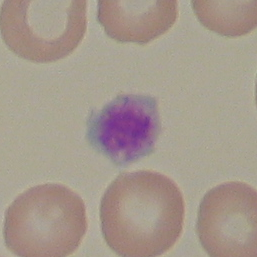

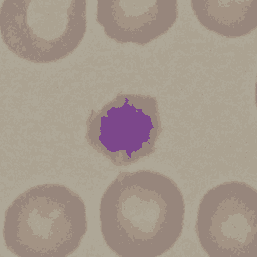

fitness =  435594.2816351293
PSNR =  38.007672052829
end 188 image


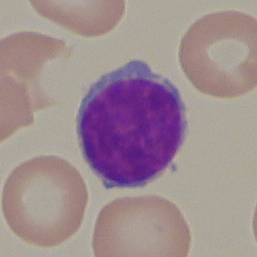

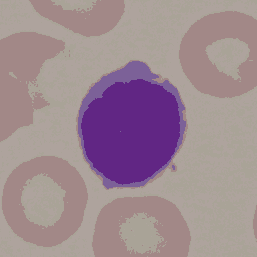

fitness =  573167.0699116476
PSNR =  34.49016418793811
end 189 image


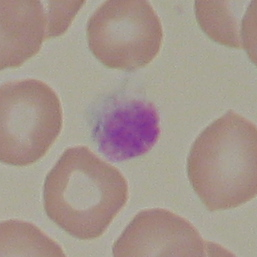

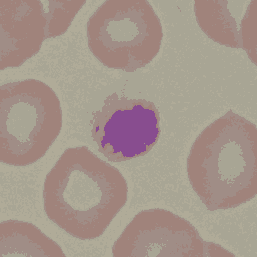

fitness =  447606.73111612455
PSNR =  37.05889251864934
end 190 image


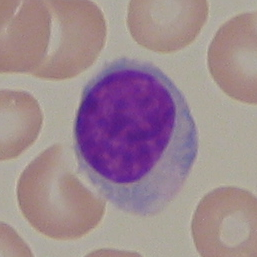

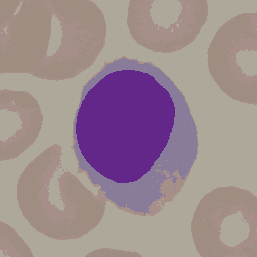

fitness =  605060.8512848067
PSNR =  33.70432671963222
end 191 image


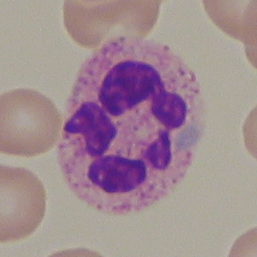

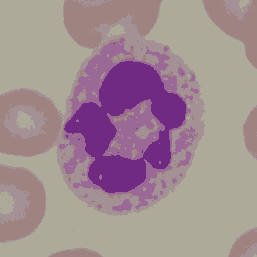

fitness =  633388.7311765178
PSNR =  34.13416512083166
end 192 image


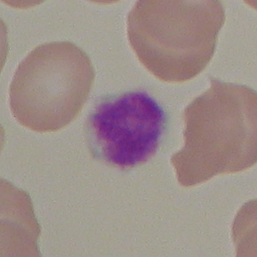

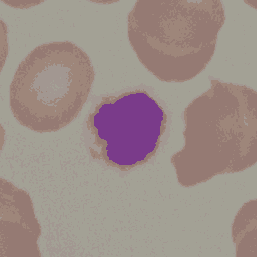

fitness =  464065.5362447956
PSNR =  36.62828096036891
end 193 image


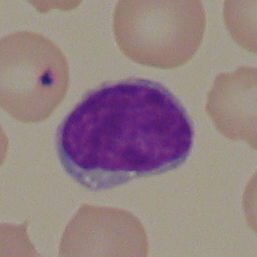

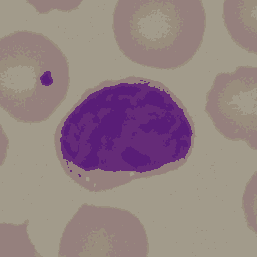

fitness =  497193.1237786254
PSNR =  37.19799062823141
end 194 image


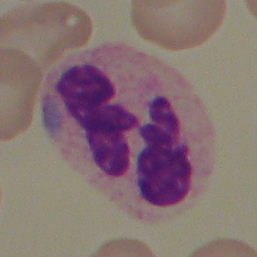

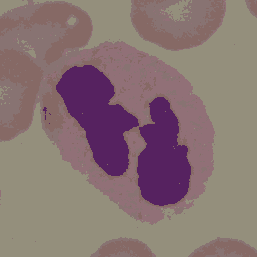

fitness =  580656.3865937644
PSNR =  34.36258278085467
end 195 image


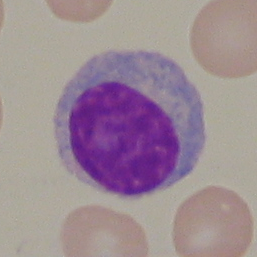

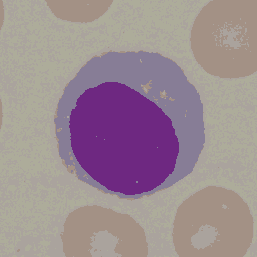

fitness =  552995.5188732471
PSNR =  34.97302179244389
end 196 image


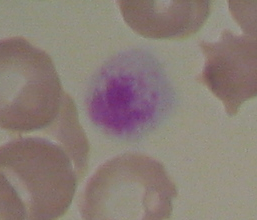

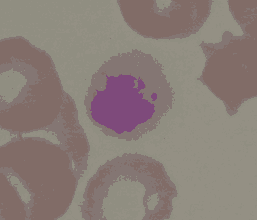

fitness =  436218.768886177
PSNR =  36.23150702023773
end 197 image


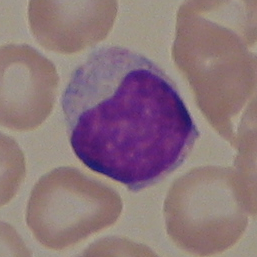

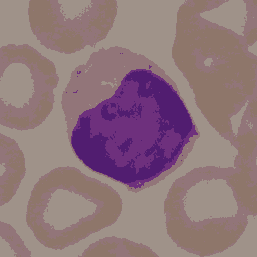

fitness =  678534.1596800326
PSNR =  33.248374969944265
end 198 image


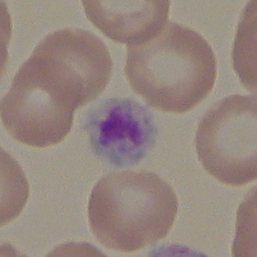

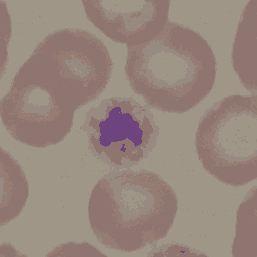

fitness =  466406.38575923425
PSNR =  36.682921311334205
end 199 image


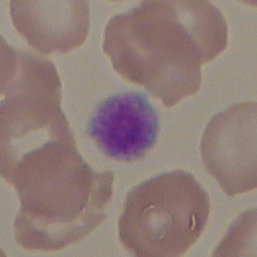

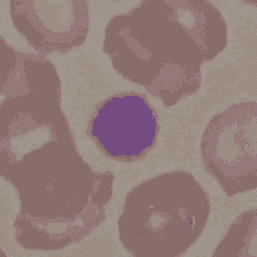

fitness =  540181.5581057181
PSNR =  35.76518552454333
end 200 image


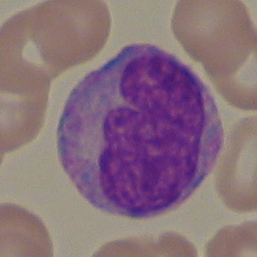

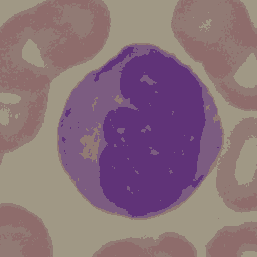

fitness =  672165.4257771678
PSNR =  33.42535414496014
end 201 image


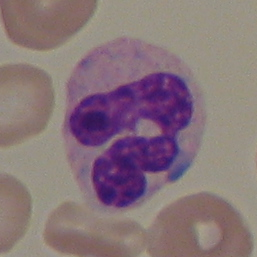

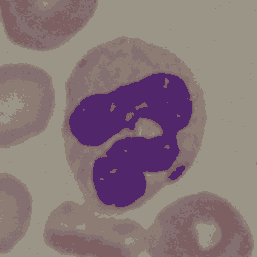

fitness =  692735.2932367754
PSNR =  34.12621856965876
end 202 image


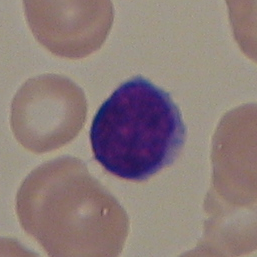

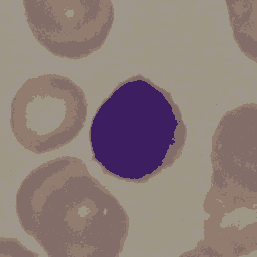

fitness =  542202.3162087612
PSNR =  35.55204902130286
end 203 image


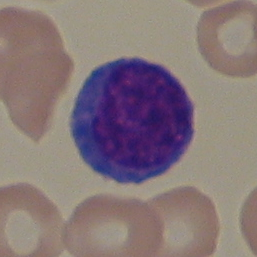

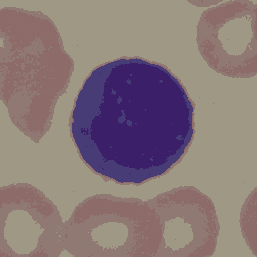

fitness =  587014.4184318468
PSNR =  34.734222974598744
end 204 image


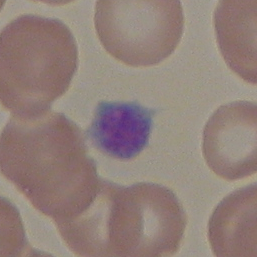

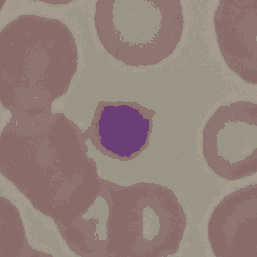

fitness =  482232.7054352931
PSNR =  35.801211094992595
end 205 image


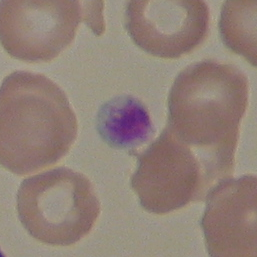

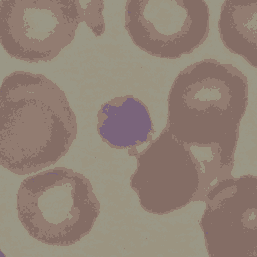

fitness =  517809.5408131774
PSNR =  35.678593832231506
end 206 image


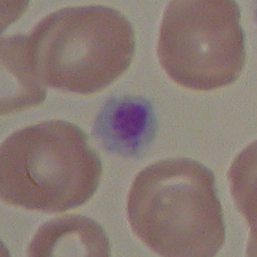

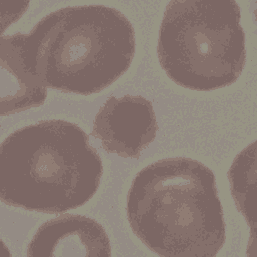

fitness =  513538.75988197245
PSNR =  37.65385421141489
end 207 image


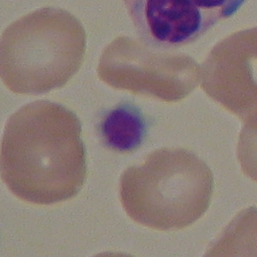

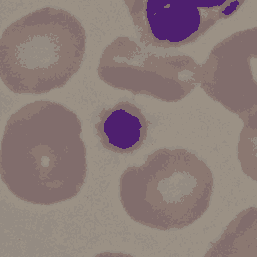

fitness =  545536.405348152
PSNR =  36.092364152171534
end 208 image


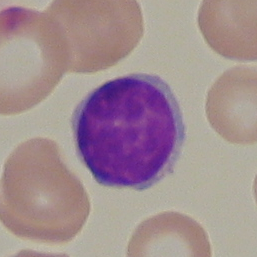

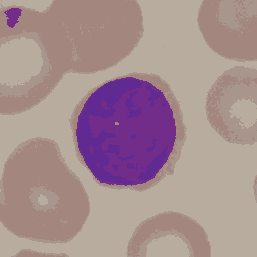

fitness =  682556.3835588866
PSNR =  34.25946853558316
end 209 image


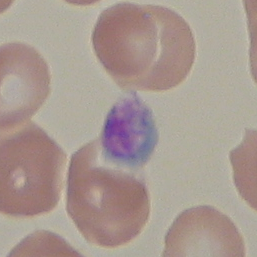

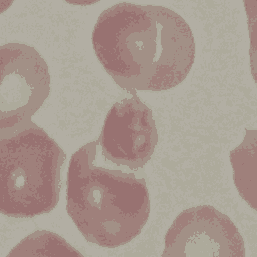

fitness =  526037.450281012
PSNR =  35.991225302822436
end 210 image


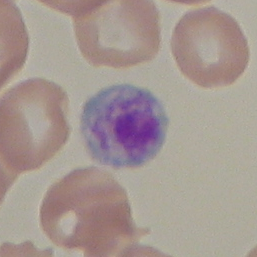

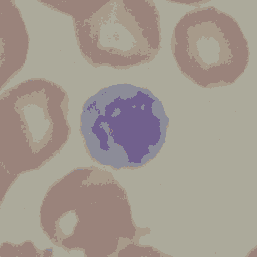

fitness =  581151.7954729561
PSNR =  34.37054330040199
end 211 image


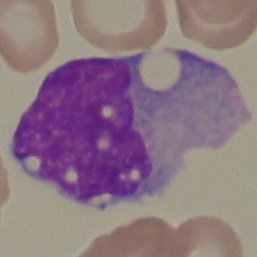

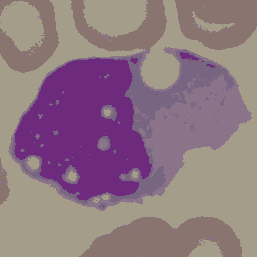

fitness =  709011.278163194
PSNR =  32.46468079427396
end 212 image


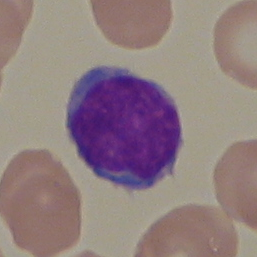

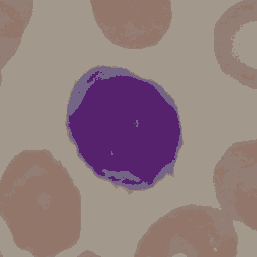

fitness =  567721.8747430928
PSNR =  34.92003032212424
end 213 image


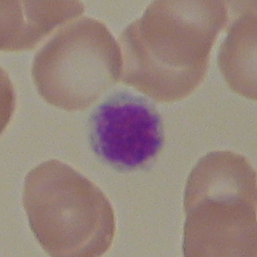

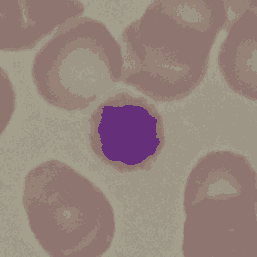

fitness =  499790.722719848
PSNR =  35.98833625846013
end 214 image


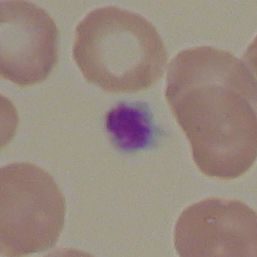

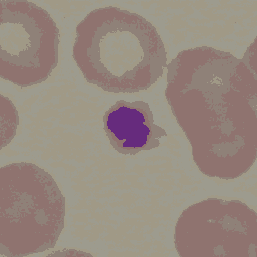

fitness =  439742.6435329203
PSNR =  37.15935852138528
end 215 image


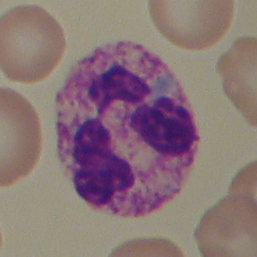

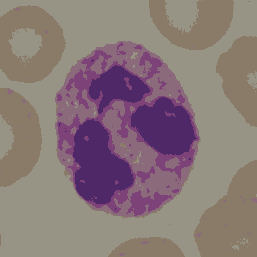

fitness =  741728.4204602387
PSNR =  32.42949992876269
end 216 image


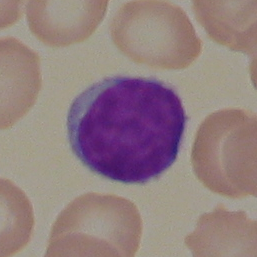

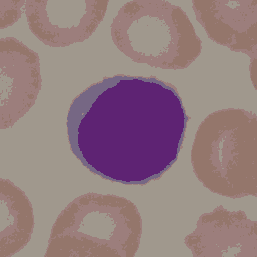

fitness =  560015.8095326937
PSNR =  35.19918430539487
end 217 image


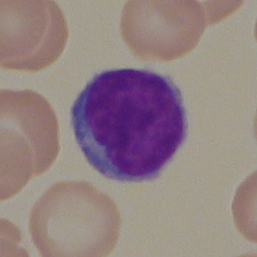

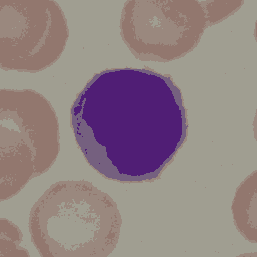

fitness =  547082.7221380529
PSNR =  35.521296369830715
end 218 image


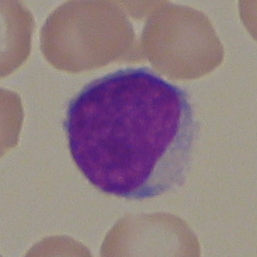

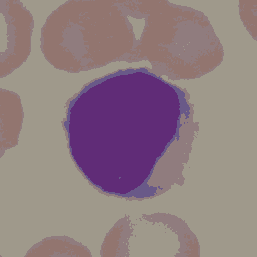

fitness =  528809.3413582616
PSNR =  34.98765481557759
end 219 image


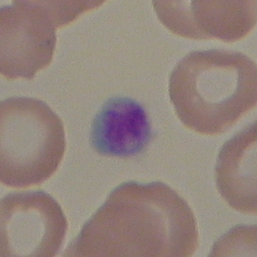

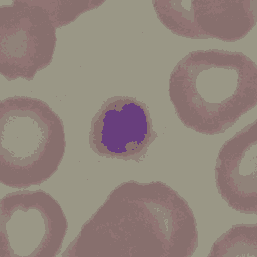

fitness =  473031.87426640064
PSNR =  37.166725158549944
end 220 image


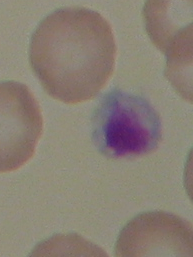

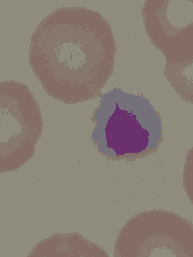

fitness =  360114.43068232696
PSNR =  37.78469344465271
end 221 image


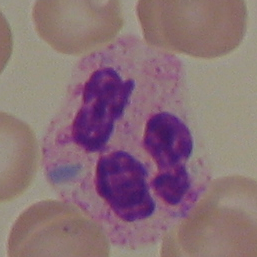

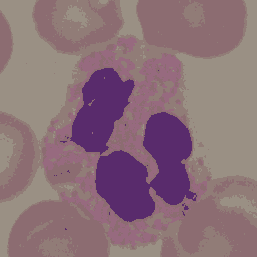

fitness =  742928.7315643375
PSNR =  33.71278234928769
end 222 image


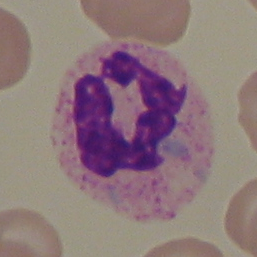

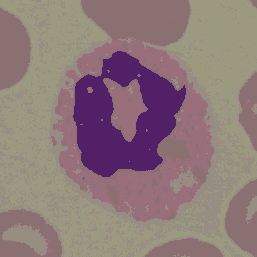

fitness =  685390.8803907556
PSNR =  34.25969327306507
end 223 image


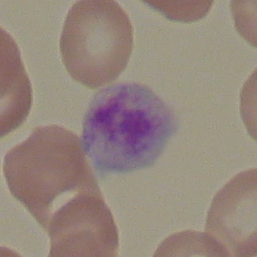

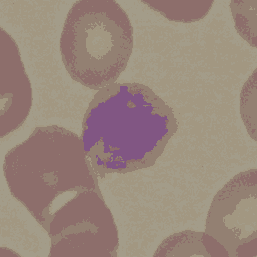

fitness =  567938.1134941584
PSNR =  35.31608189986354
end 224 image


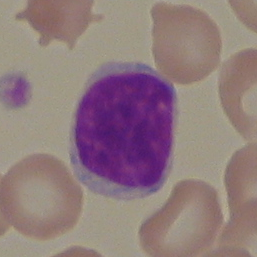

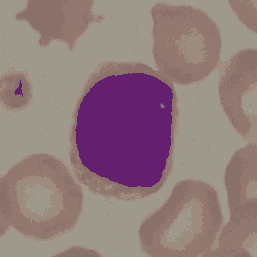

fitness =  580758.1883075983
PSNR =  35.66890470488443
end 225 image


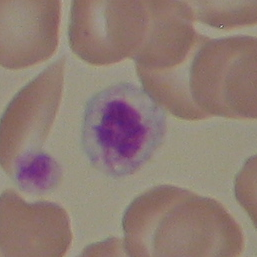

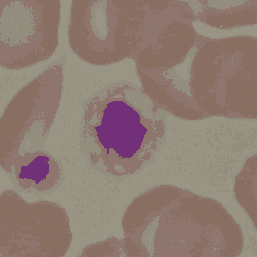

fitness =  537985.0899570967
PSNR =  35.57250350886645
end 226 image


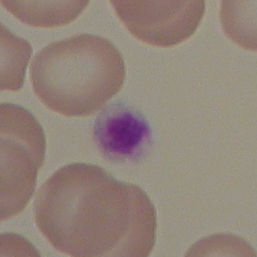

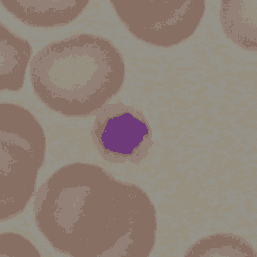

fitness =  511146.9785173149
PSNR =  36.24023242382029
end 227 image


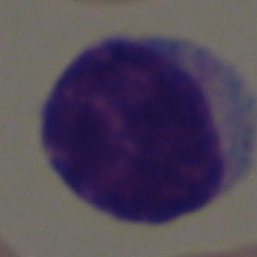

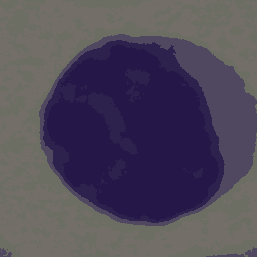

fitness =  497395.43253949424
PSNR =  35.3050707516534
end 228 image


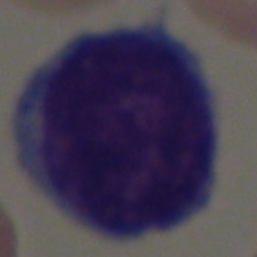

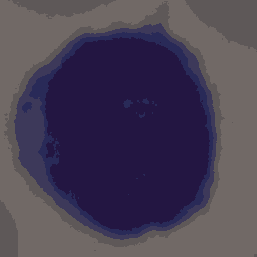

fitness =  546060.8781218115
PSNR =  35.509589016835136
end 229 image


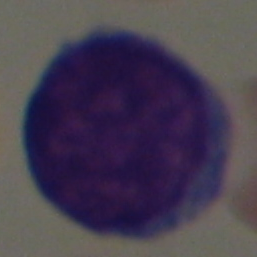

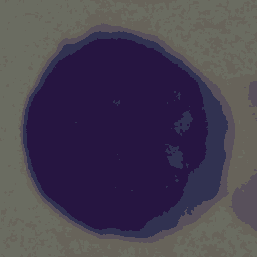

fitness =  541652.7001233244
PSNR =  35.22777482009968
end 230 image


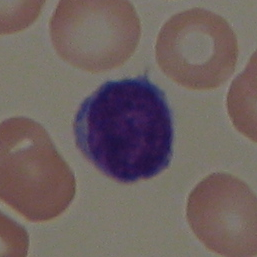

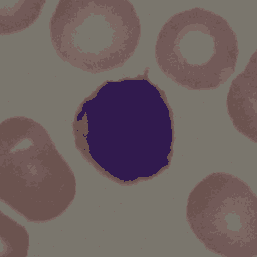

fitness =  483879.03433245997
PSNR =  36.71874874227684
end 231 image


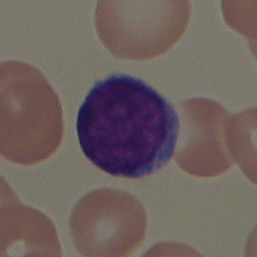

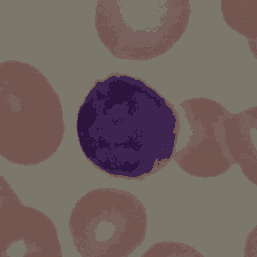

fitness =  486421.61687566
PSNR =  36.29705168864723
end 232 image


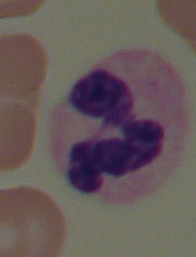

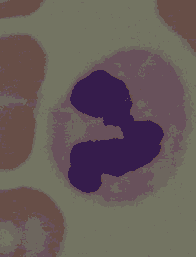

fitness =  441726.5960252796
PSNR =  36.334025390489515
end 233 image


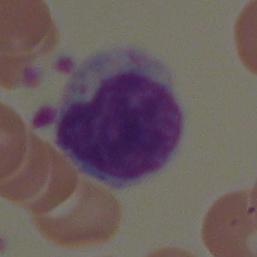

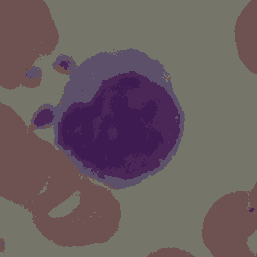

fitness =  536778.5579484762
PSNR =  34.428570359644844
end 234 image


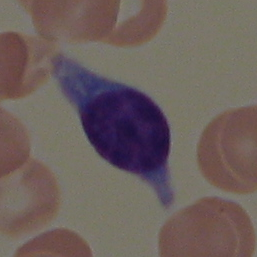

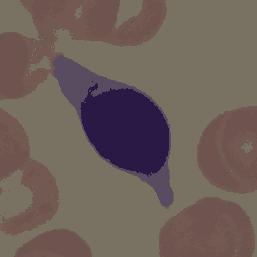

fitness =  583226.5106506117
PSNR =  35.34801523488027
end 235 image


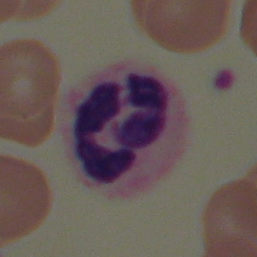

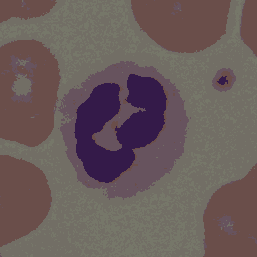

fitness =  583682.4568255479
PSNR =  34.604724094510594
end 236 image


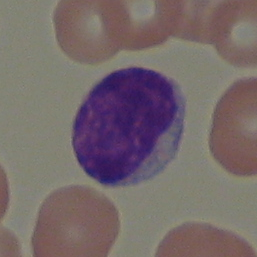

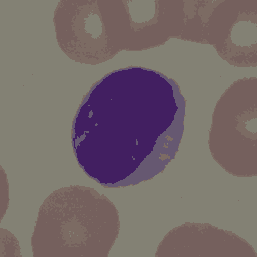

fitness =  503689.60984888405
PSNR =  35.47833036531796
end 237 image


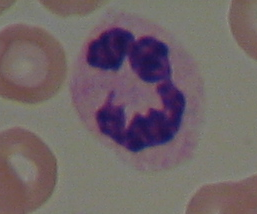

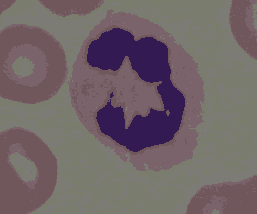

fitness =  447401.0631424111
PSNR =  36.42917883207054
end 238 image


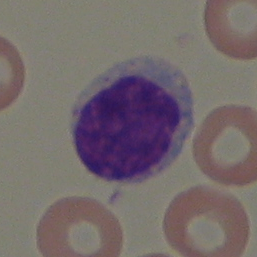

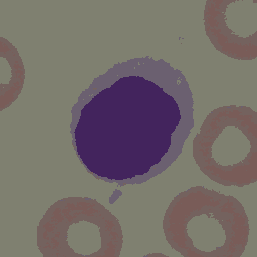

fitness =  504692.5699096556
PSNR =  35.83408037424713
end 239 image


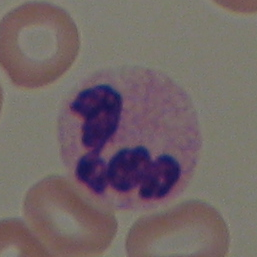

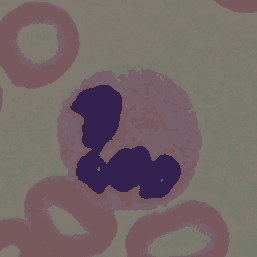

fitness =  551059.7207440828
PSNR =  35.982981667664134
end 240 image


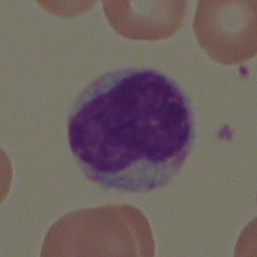

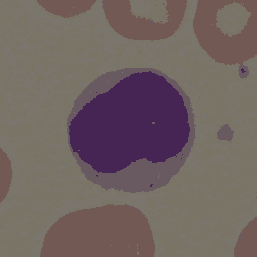

fitness =  420770.13460325095
PSNR =  36.32058774400614
end 241 image


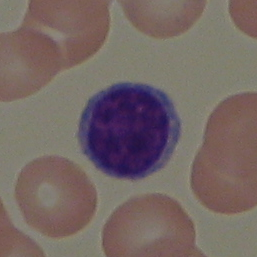

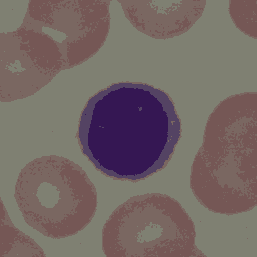

fitness =  502675.42216338863
PSNR =  36.15030330834776
end 242 image


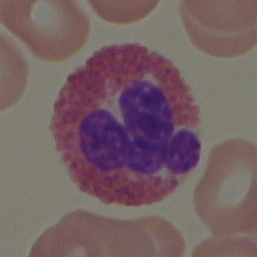

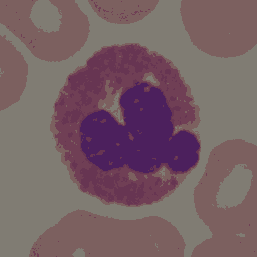

fitness =  560765.2503765704
PSNR =  35.02063219344217
end 243 image


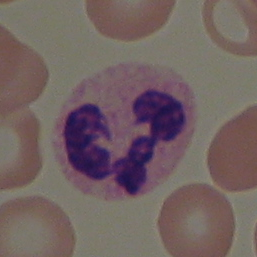

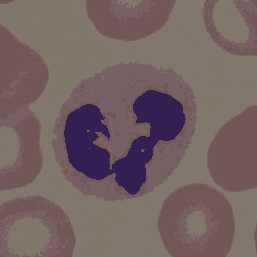

fitness =  567408.5704331612
PSNR =  35.691019357803846
end 244 image


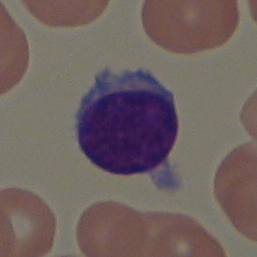

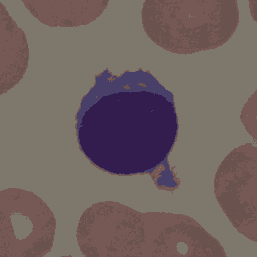

fitness =  476658.7599468175
PSNR =  36.579643149510936
end 245 image


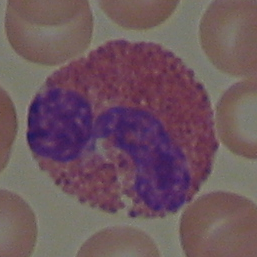

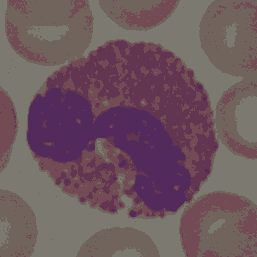

fitness =  652077.6976582989
PSNR =  34.1779386777163
end 246 image


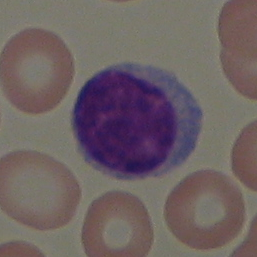

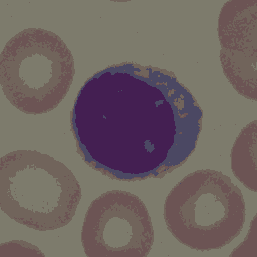

fitness =  548822.0044305683
PSNR =  35.13598982153436
end 247 image


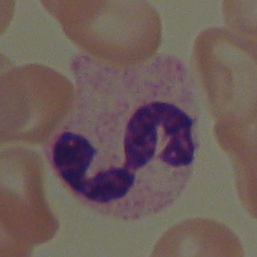

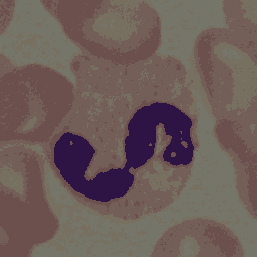

fitness =  596197.149818486
PSNR =  35.35852599494326
end 248 image


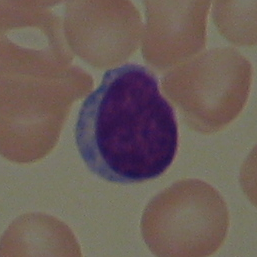

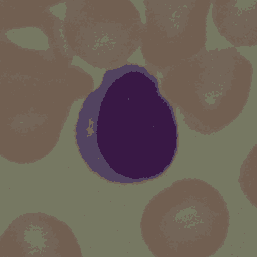

fitness =  497513.3318369117
PSNR =  36.271103572473805
end 249 image


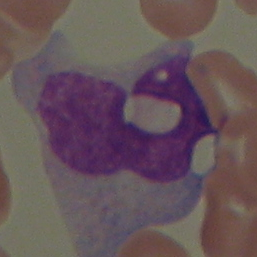

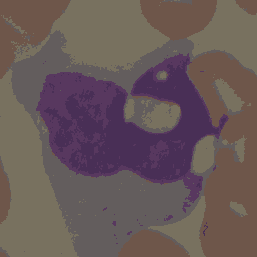

fitness =  669837.9589955258
PSNR =  33.780410868726506
end 250 image


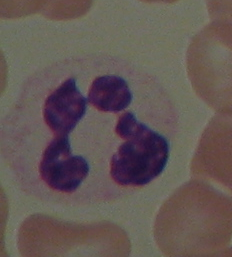

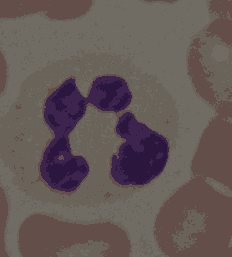

fitness =  499125.10172016936
PSNR =  36.51430647727425
end 251 image


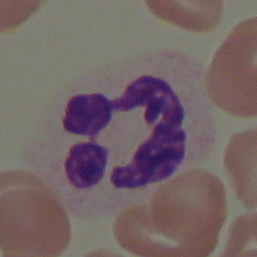

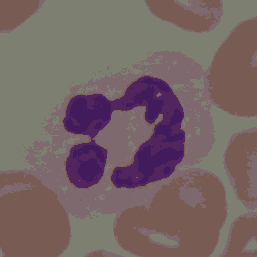

fitness =  540427.8429876462
PSNR =  35.834161110669896
end 252 image


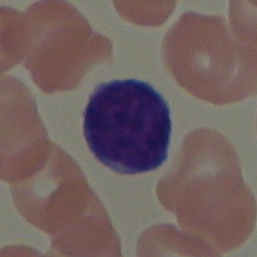

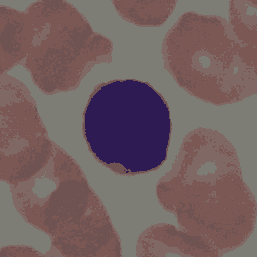

fitness =  560890.2789179741
PSNR =  36.015252782154114
end 253 image


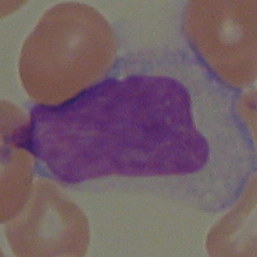

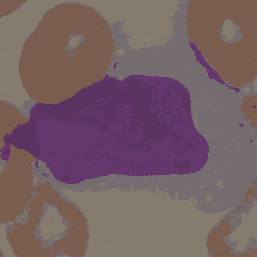

fitness =  660550.8208900773
PSNR =  34.55988873936028
end 254 image


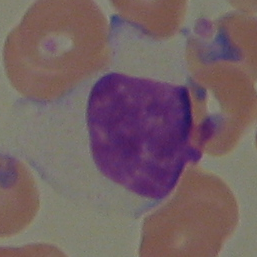

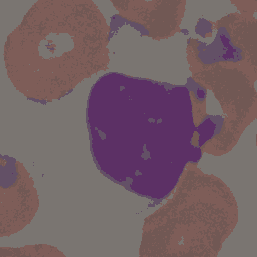

fitness =  674312.4661244897
PSNR =  32.95443420037377
end 255 image


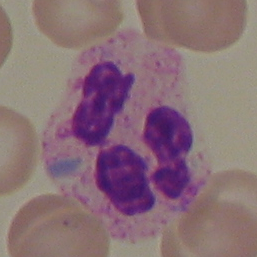

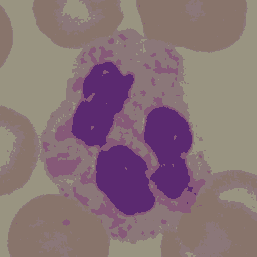

fitness =  712118.2079943814
PSNR =  33.04663845618328
end 256 image


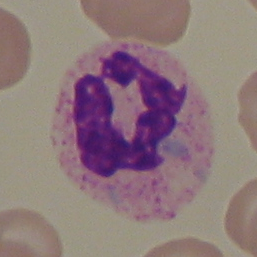

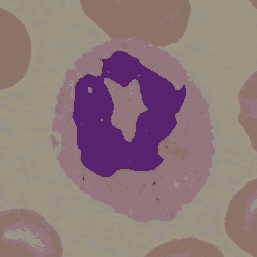

fitness =  605348.8473863897
PSNR =  34.110935126385456
end 257 image


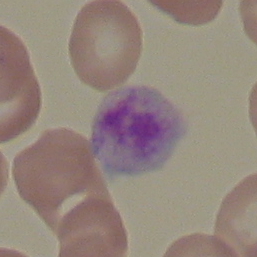

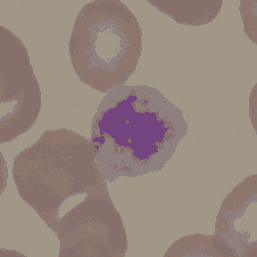

fitness =  507542.39792201994
PSNR =  35.62021703803184
end 258 image


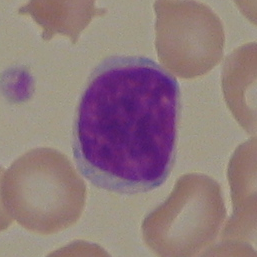

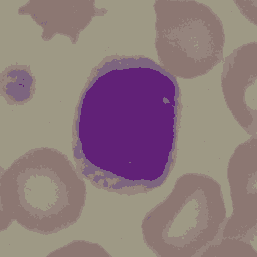

fitness =  558621.3219696609
PSNR =  35.05410283010458
end 259 image


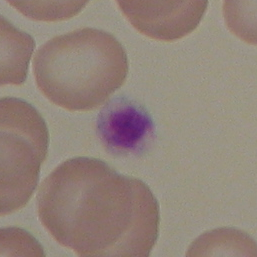

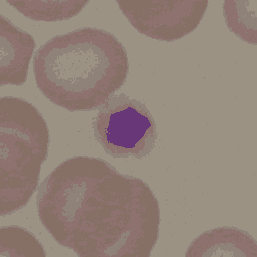

fitness =  420444.1859856917
PSNR =  38.09502641091002
end 260 image
average fitness =  608922.2304555814
average psnr =  34.76781397656102


In [ ]:
sumfit = 0
sumpsnr = 0
for i in range(1, 261):
  path = "/content/Im"
  if(i < 10):
    path += "0"
  if(i < 100):
    path += "0"
  path += str(i)
  path += "_"
  if(i < 131):
    path += "1"
  else:
    path += "0"
  path += ".tif"
  img = cv2.imread(path, 1)
  rimg = np.reshape(img, (-1, 3))
  colors = np.unique(rimg, axis = 0)
  ft, psn = GA(img, 20, 5, 0.5, 0.5, 20)
  sumfit += ft
  sumpsnr += psn
  #cv2_imshow(img)
  #cv2_imshow(bestpic)
  print(f"end {i} image")

print("average fitness = ", sumfit / 260)
print("average psnr = ", sumpsnr / 260)

average fitness = 608922.2304555814

average psnr = 34.76781397656102